In [12]:
import matplotlib.pyplot as plt
import numpy as np
import os, scipy
import matplotlib.colors as mcolors
import networkx as nx
import pickle

if os.getcwd().split(os.sep)[-1] == "examples":
    os.chdir('..')
    os.chdir('..')
    os.chdir('..')
    os.chdir('..')

# We import the model, stimuli, and the optimal control package
from neurolib.models.wc import WCModel
from neurolib.utils.stimulus import ZeroInput
from neurolib.control.optimal_control import oc_wc, cost_functions
from neurolib.control.optimal_control.oc_utils.plot_oc import plot_oc_nw

# This will reload all imports as soon as the code changes
%load_ext autoreload
%autoreload 2

options = {
    'node_color': 'lightgray',
    'node_size': 1000,
    'width': 2,
    'arrowstyle': '-|>',
    'arrowsize': 20,
    'font_size' : 20,
    'font_weight' : 'bold',
    }

dir = "images_5n"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [95]:
def draw_nwgraph(cmat, filename):
    G = nx.DiGraph() 
    for n in range(cmat.shape[0]):
            for l in range(cmat.shape[1]):
                if cmat[n,l] != 0:
                    G.add_edge(l,n)
    nx.draw(G, with_labels=True, arrows=True, **options)
    plt.savefig(os.path.join(dir,filename), bbox_inches='tight')
    plt.show()

def getperiods(x, dt, N, prominence=0.01, interval=(None, None)):

    timing_list = [None for n in range(N)]
    periods_list = [None for n in range(N)]

    if interval[0] is None:
        interval[0] = 0
    if interval[1] is None:
        interval[1] = -1

    for n in range(N):
        timing_list[n] = scipy.signal.find_peaks(x[n, 0, interval[0]:interval[1]], prominence=prominence)[0]
        periods_list[n] = []
        if len(timing_list[n]) < 3:
            continue
        for pind in range(1, len(timing_list[n])):
            periods_list[n].append(dt * (timing_list[n][pind]-timing_list[n][pind-1]))

    return timing_list, periods_list

def getperiod(x, dt):
    periods = []
    for n in range(x.shape[0]):
        peaks = scipy.signal.find_peaks(x[n,:])[0]
        for p in range(2, len(peaks)-1):
            periods.append(peaks[p] - peaks[p-1])
        
        return np.mean(periods) * dt

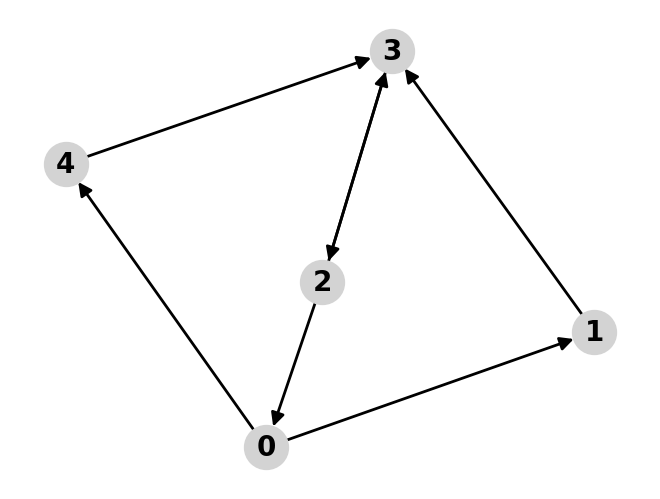

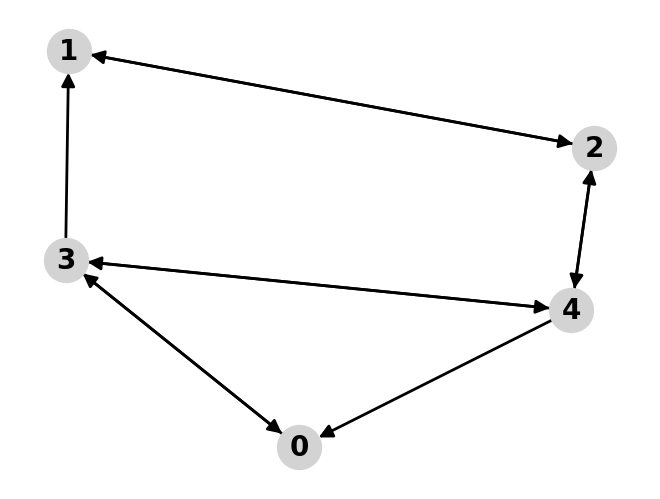

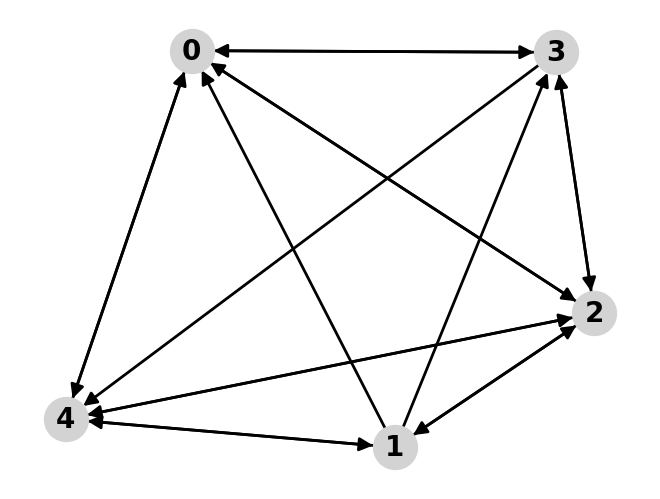

In [101]:
N = 5
cmats, dmats = [], []

while len(cmats) < 3:
    p_connect = 0.1 * (len(cmats) + 1)**2
    p_inv = 1. - p_connect
    cmat = np.random.choice([0, 1], size=(N,N), p=[p_inv, p_connect])
    use = True
    for n in range(N):
        cmat[n, n] = 0
        if np.amax(cmat[n,:]) == 0:
            use = False
            break
        if np.amax(cmat[:,n]) == 0:
            use = False
            break

    for j in range(len(cmats)):
        if (cmat == cmats[j]).all():
            use = False

    if use:
 
        draw_nwgraph(cmat, "network_" + str(len(cmat)) + ".png")
        cmats.append(cmat)

        dmat = np.random.random((N, N))
        for n1 in range(N):
            for n2 in range(N):
                dmat[n1, n2] *= 30. * cmat[n1,n2]

        dmats.append(np.around(dmat, 0))
        #print(dmats[-1])

In [102]:
colors = []
n = 0
for col in mcolors.TABLEAU_COLORS:
    colors.append(col)
    n += 1
    if n >= N: break

points = [ [1.5, 0.], [2., 0.], [1.5, 0.5], [2., 0.5], [2., 1.] ]

periods_array = np.zeros((len(cmats), len(points)))

In [141]:
plt_list = [[0,4], [1,2], [1,4], [2,1], [2,3], [2,4]]

----------------
0 0


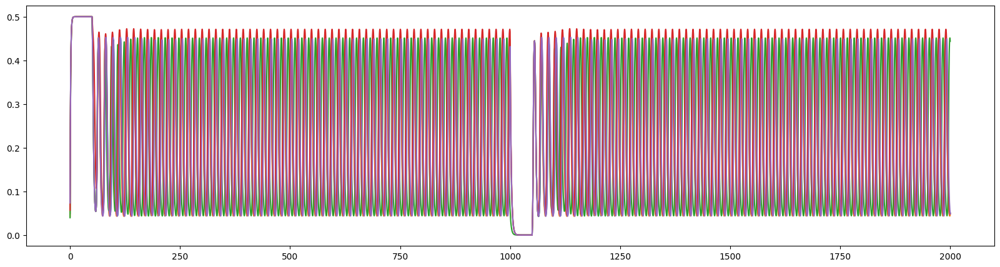

period =  15.530434782608697
period diff =  0.0
----------------
0 1


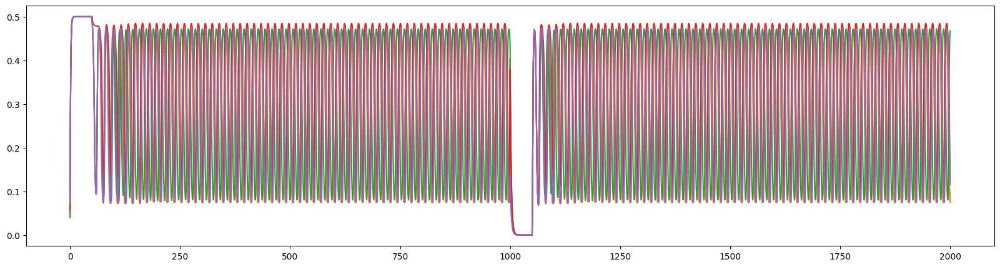

period =  15.827272727272728
period diff =  0.0
----------------
0 2


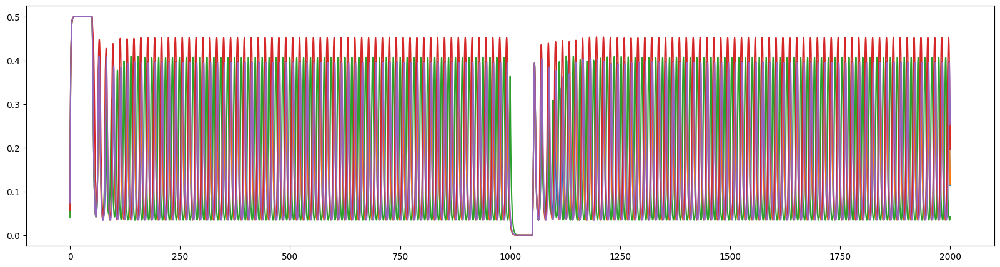

period =  15.686956521739132
period diff =  0.0005928853754948449
----------------
0 3


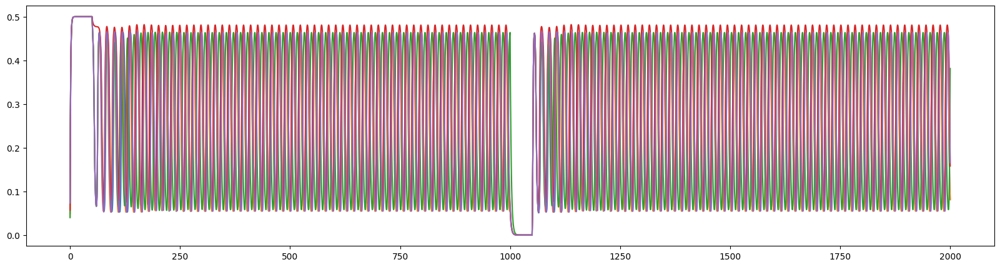

period =  16.11818181818182
period diff =  0.004545454545457517
----------------
0 4


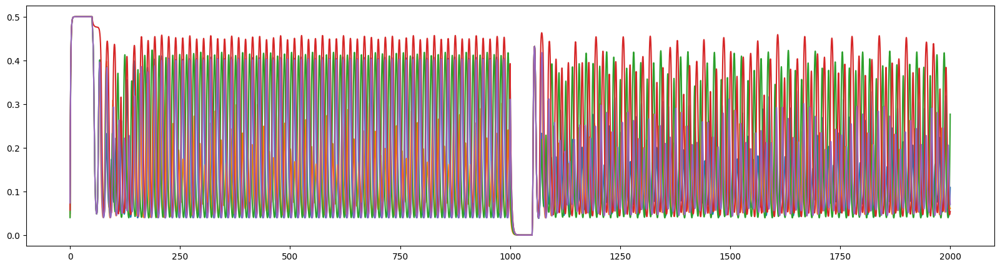

period =  12.033333333333333
period diff =  -3.83939393939394
----------------
1 0


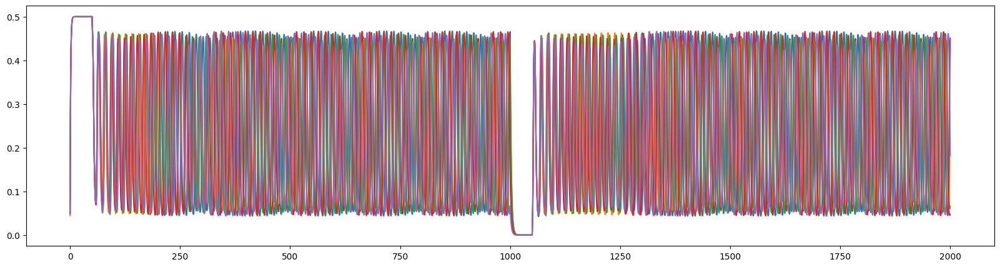

period =  16.461904761904762
period diff =  -0.004761904761902969
----------------
1 1


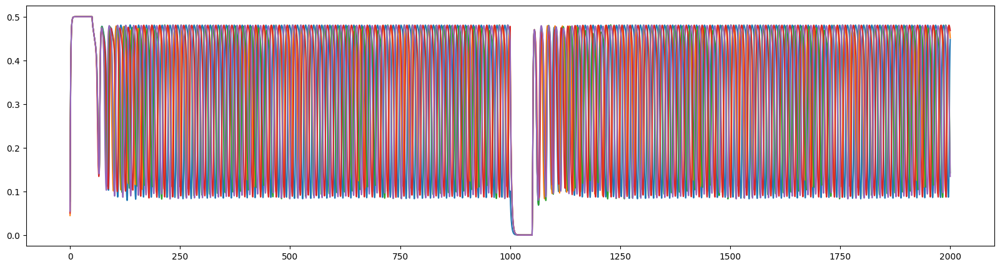

period =  18.1
period diff =  0.0210526315789501
----------------
1 2


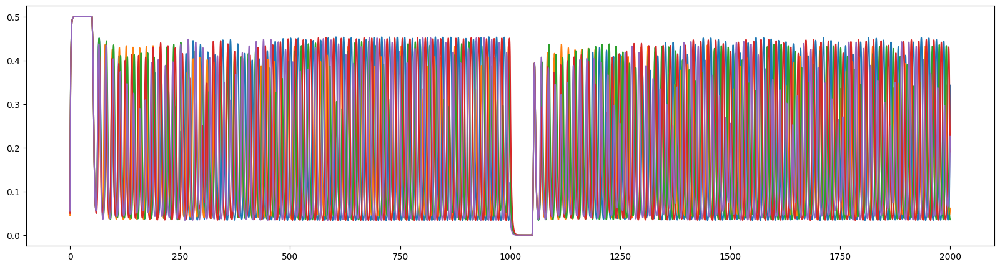

period =  17.085
period diff =  -0.28500000000000014
----------------
1 3


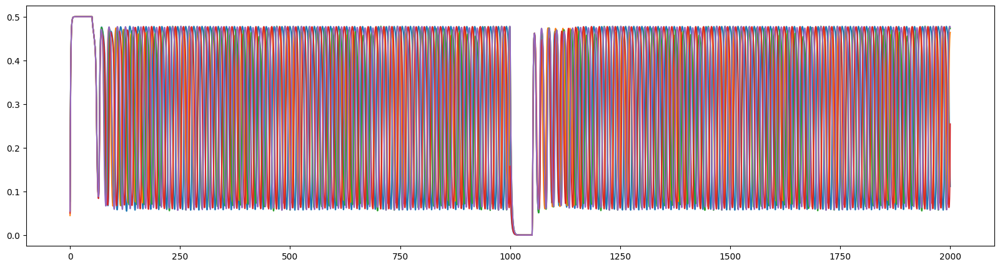

period =  18.147368421052633
period diff =  -0.00526315789473486
----------------
1 4


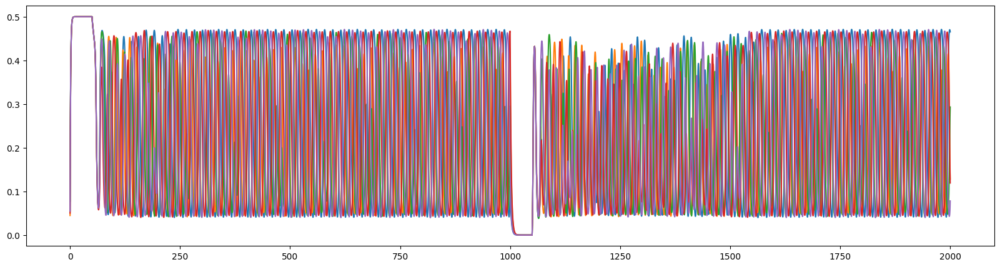

period =  18.573684210526316
period diff =  -0.004093567251462815
----------------
2 0


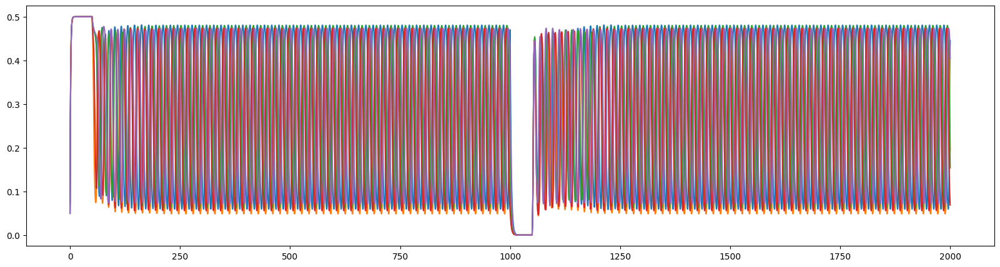

period =  16.45714285714286
period diff =  0.0
----------------
2 1


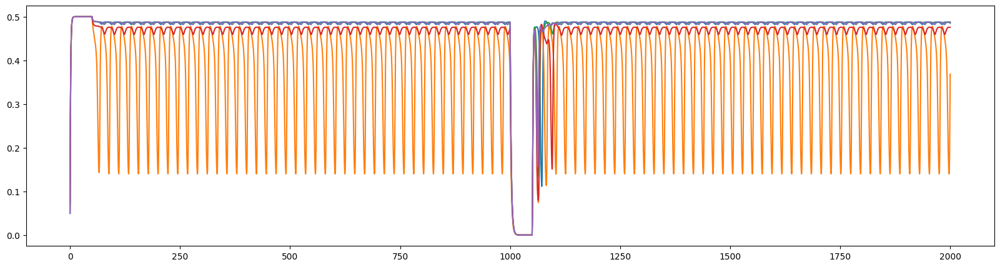

period =  22.346666666666668
period diff =  0.0
----------------
2 2


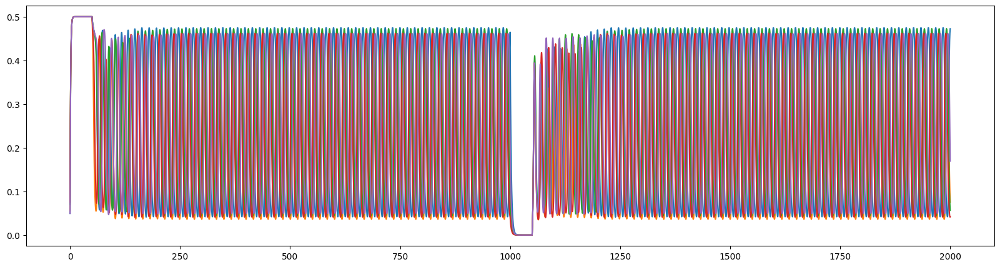

period =  16.77
period diff =  0.0
----------------
2 3


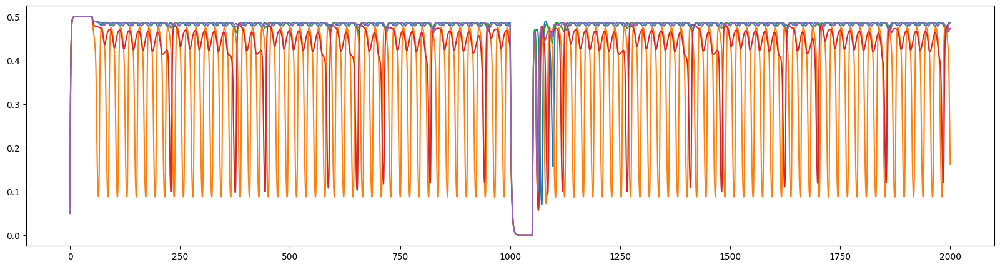

period =  20.368750000000002
period diff =  0.08639705882353255
----------------
2 4


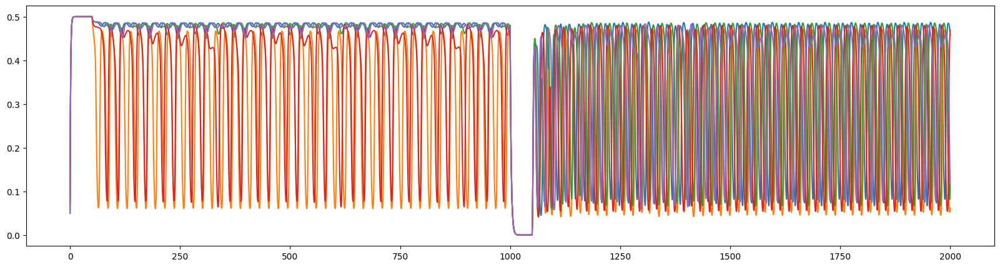

period =  20.029411764705884
period diff =  -1.697254901960786


In [147]:

for c in range(len(cmats)):
    model = WCModel(Cmat=cmats[c], Dmat=dmats[c])

    dt = model.params['dt']
    model.params['duration'] = 2. * 1000
    model.params.signalV = 1.

    zero_input = ZeroInput().generate_input(duration=model.params['duration']+model.params.dt, dt=model.params.dt)
    rect_input = np.vstack( (zero_input)*2 )
    rect_input[0,:500] = 5.
    rect_input[0,10000:10500] = -5.

    for pind in range(len(points)):
        print("----------------")
        print(c, pind)
        model.params["exc_ext"] = points[pind][0] + rect_input[0,:]
        model.params["inh_ext"] = points[pind][1]
        model.run()

        if [c, pind] in plt_list or True:
            fig, ax = plt.subplots(figsize=(20,5))
            for n in range(N):
                ax.plot(model.t, model.exc[n,:], color=colors[n])
            plt.show()

        periods_array[c, pind] = getperiod(model.exc[:,-4000:], dt)
        print("period = ", periods_array[c, pind])
        alt_period = getperiod(model.exc[:,6000:10000], dt)
        print("period diff = ", periods_array[c, pind] - alt_period)

In [219]:
controlmat = np.zeros((N,2))
controlmat[:,0] = 1.

costmat = np.zeros((N, 2))
costmat[:,0] = 1.

duration = 200.
model.params.duration = duration
zero_input0 = ZeroInput().generate_input(duration=duration+model.params.dt, dt=model.params.dt)
zero_input = np.vstack( ([zero_input0]*2) )[np.newaxis,:,:]
zero_control = np.vstack( ([zero_input]*N))

results = dict()
results["controls"] = [[[ None for x2 in range(4)] for x3 in range(len(points))] for x4 in range(len(cmats)) ]
results["periods"] =  [[[ None for x2 in range(4)] for x3 in range(len(points))] for x4 in range(len(cmats)) ]
results["timings"] =  [[[ None for x2 in range(4)] for x3 in range(len(points))] for x4 in range(len(cmats)) ]
results["states"] =  [[[ None for x2 in range(4)] for x3 in range(len(points))] for x4 in range(len(cmats)) ]
results["nat_periods"] =  np.zeros((len(cmats), len(points), 4 ))
results["w2"] = np.zeros((len(cmats), len(points), 4 ))

In [246]:
skip_array = [[2,1], [2,3], [2,4]]

results["controls"][1][4][3] = None
results["w2"][1][4][3] = 0.

c =  0
pind =  0
target period =  15.530434782608697
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.9762963839701478
Converged in iteration 2 with cost -0.9762963839701478
Final cost : -0.9762963839701478
Compute control for a deterministic system
Cost in iteration 0: -0.9762963839701478
Converged in iteration 1 with cost -0.9762963839701478
Final cost : -0.9762963839701478


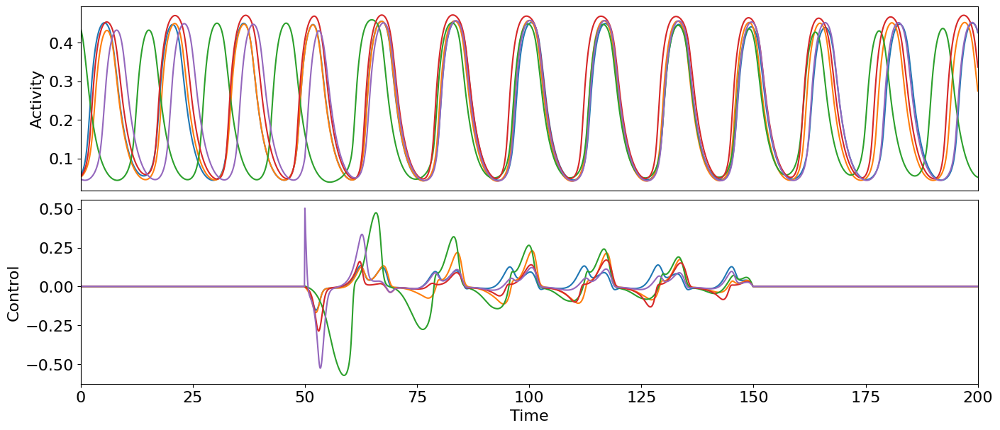

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1.3418394889647356
Converged in iteration 1 with cost -1.3418394889647356
Final cost : -1.3418394889647356
Compute control for a deterministic system
Cost in iteration 0: -1.3418394889647356
Converged in iteration 1 with cost -1.3418394889647356
Final cost : -1.3418394889647356


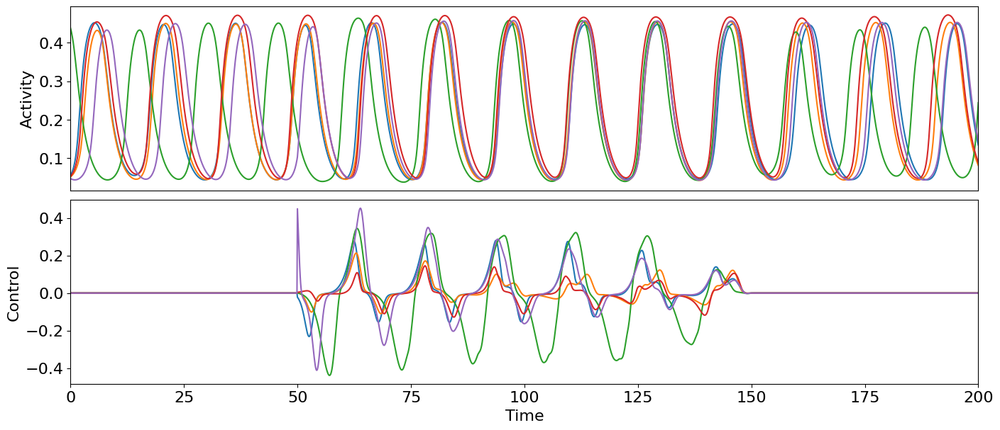

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1577.4018897869582
Converged in iteration 1 with cost -1577.4018897869582
Final cost : -1577.4018897869582
Compute control for a deterministic system
Cost in iteration 0: -1577.4018897869582
Converged in iteration 1 with cost -1577.4018897869582
Final cost : -1577.4018897869582


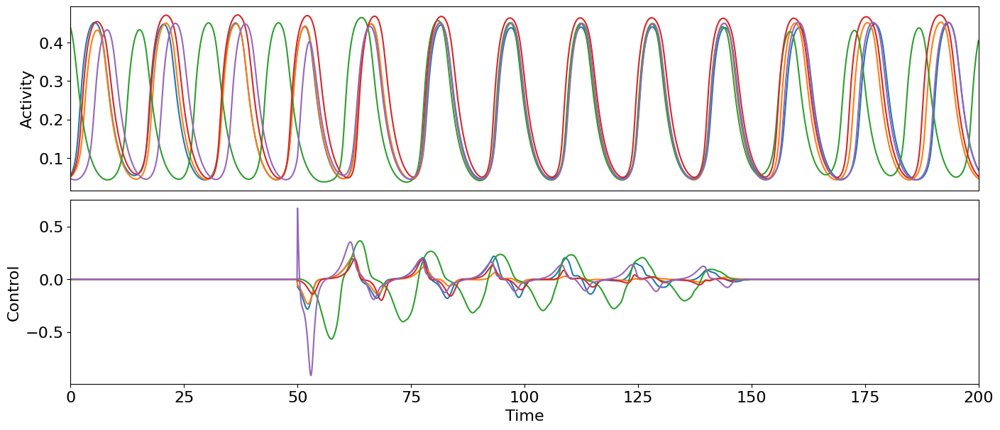

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.07440211025288135
Cost in iteration 10: 0.07363268935778598
Final cost : 0.07363268935778598
Compute control for a deterministic system
Cost in iteration 0: 0.07363268935778598
Converged in iteration 6 with cost 0.07308225441141526
Final cost : 0.07308225441141526


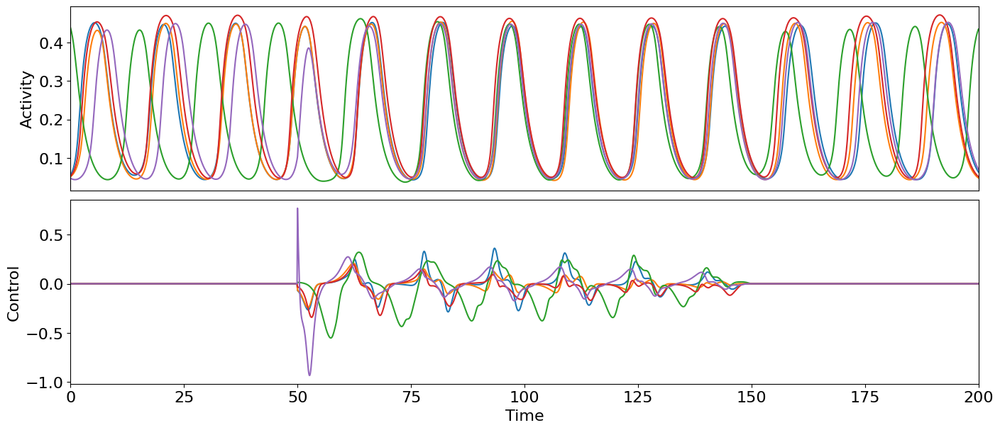

pind =  1
target period =  15.827272727272728
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1.0339513783902132
Converged in iteration 2 with cost -1.0339513783902132
Final cost : -1.0339513783902132
Compute control for a deterministic system
Cost in iteration 0: -1.0339513783902132
Converged in iteration 1 with cost -1.0339513783902132
Final cost : -1.0339513783902132


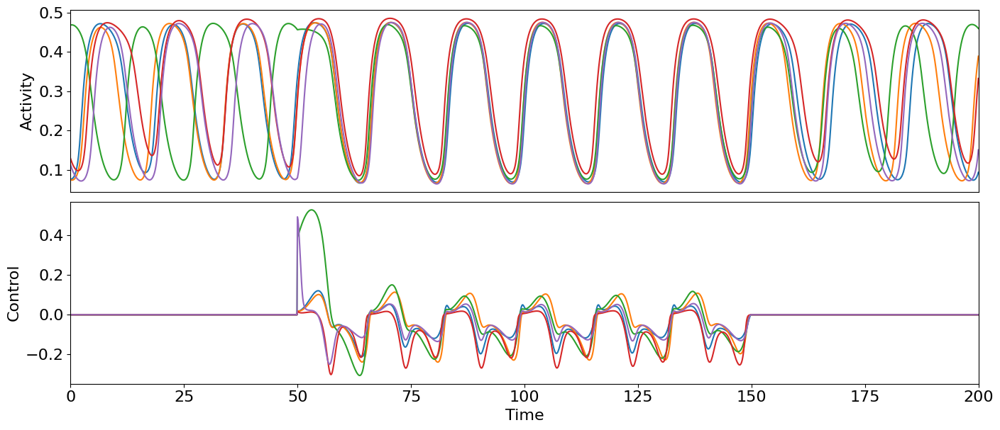

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1.986610994534419
Converged in iteration 8 with cost -1.9874636016815992
Final cost : -1.9874636016815992
control too strong, increase w2 to  0.1024
Compute control for a deterministic system
Cost in iteration 0: -0.8273429047208269
Cost in iteration 10: -1.7678618432766728
Cost in iteration 20: -1.7861652802166956
Final cost : -1.7861652802166956
Compute control for a deterministic system
Cost in iteration 0: -1.7861652802166956
Converged in iteration 5 with cost -1.7861653717897732
Final cost : -1.7861653717897732


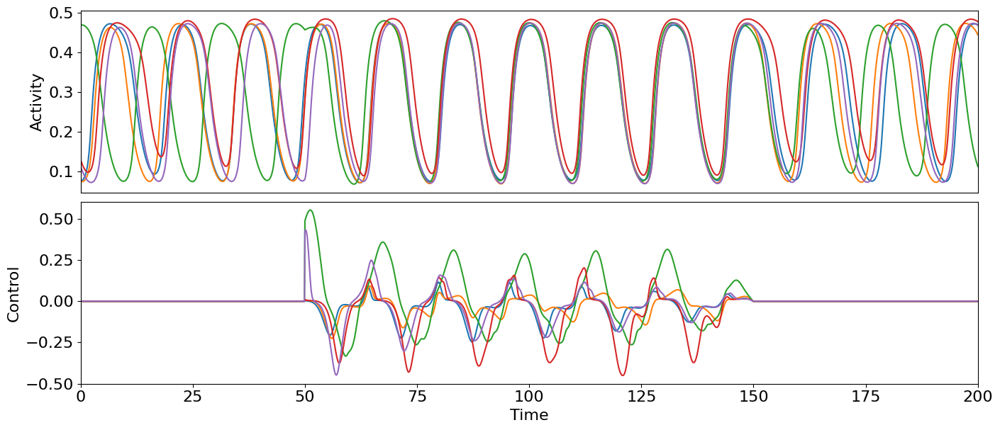

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -2386.2830974776743
Cost in iteration 10: -2387.87367241179
Final cost : -2387.87367241179
control too strong, increase w2 to  26.2144
Compute control for a deterministic system
Cost in iteration 0: -932.172157376751
Cost in iteration 10: -2294.045944285257
Cost in iteration 20: -2303.139670366457
Final cost : -2303.139670366457
Compute control for a deterministic system
Cost in iteration 0: -2303.139670366457
Cost in iteration 10: -2309.134449871014
Cost in iteration 20: -2313.2771827386964
Cost in iteration 30: -2317.923903693798
Cost in iteration 40: -2322.636270508504
Cost in iteration 50: -2324.254122468684
Cost in iteration 60: -2326.9251254514
Cost in iteration 70: -2329.867535556069
Cost in iteration 80: -2331.588745206096
Cost in iteration 90: -2333.272718963909
Cost in iteration 100: -2334.9402712992264
Converged in iteration 155 with cost -2340.76156642477

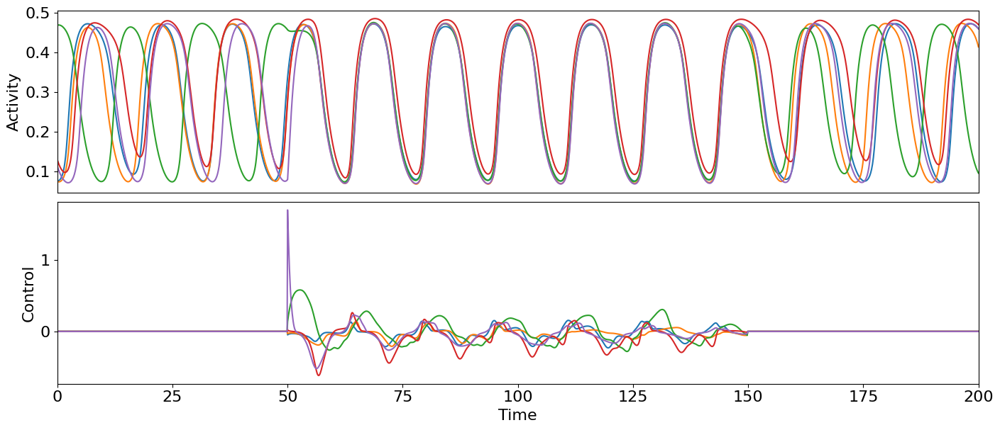

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.07170360342423772
Converged in iteration 10 with cost 0.07170360303602737
Final cost : 0.07170360303602737
Compute control for a deterministic system
Cost in iteration 0: 0.07170360303602737
Converged in iteration 1 with cost 0.07170360303602737
Final cost : 0.07170360303602737


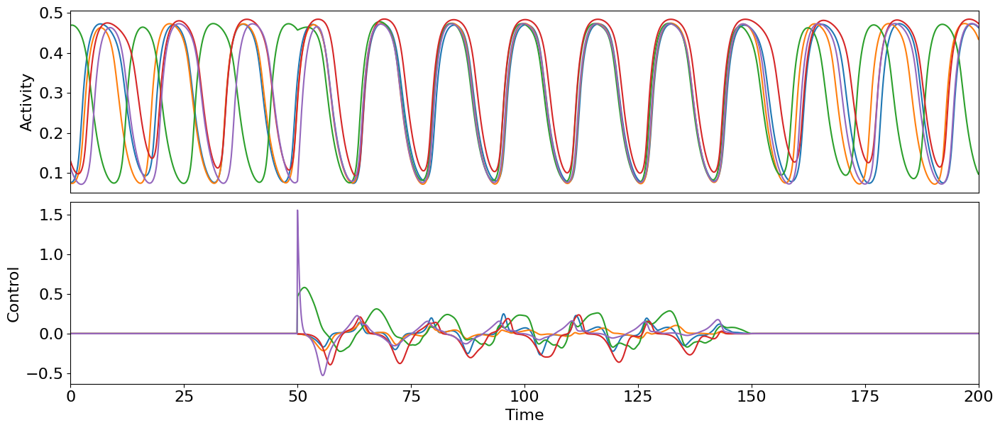

pind =  2
target period =  15.686956521739132
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.8735431005631022
Cost in iteration 10: -0.8735431005635141
Final cost : -0.8735431005635141
Compute control for a deterministic system
Cost in iteration 0: -0.8735431005635141
Converged in iteration 3 with cost -0.8735431005635143
Final cost : -0.8735431005635143


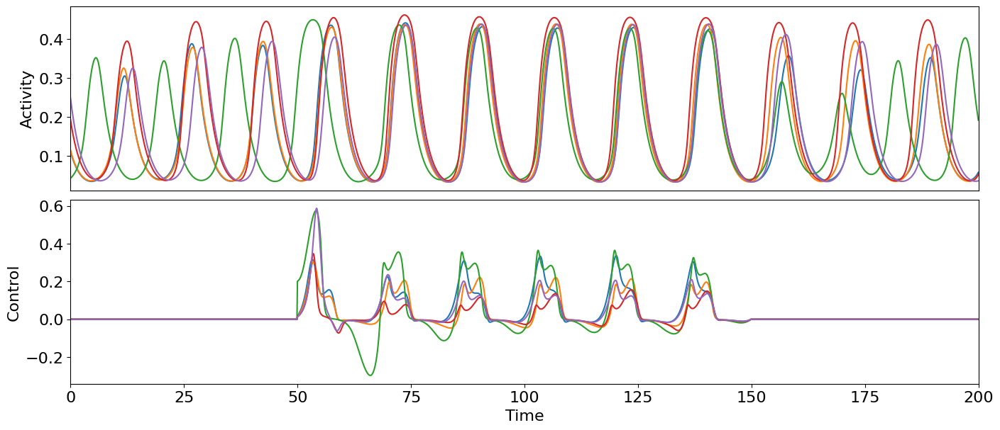

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.9874357701528222
Converged in iteration 7 with cost -0.987436351239899
Final cost : -0.987436351239899
Compute control for a deterministic system
Cost in iteration 0: -0.987436351239899
Converged in iteration 1 with cost -0.987436351239899
Final cost : -0.987436351239899


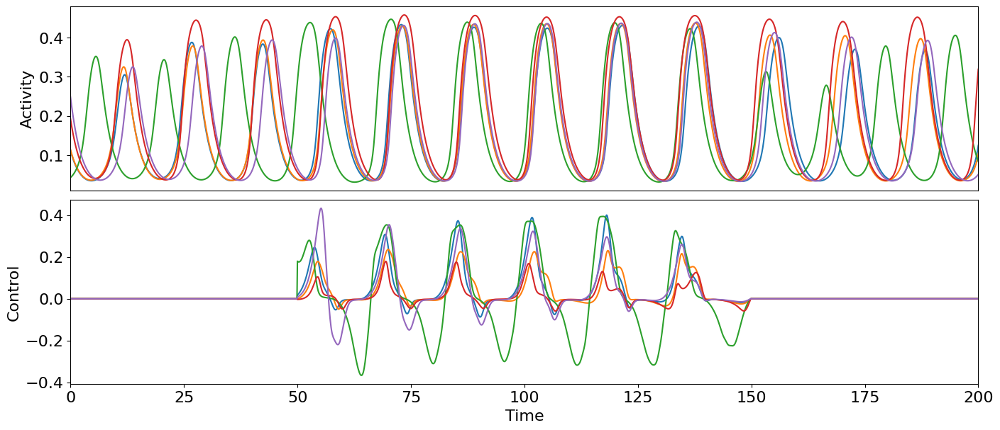

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1498.7300748528905
Converged in iteration 3 with cost -1498.741473907801
Final cost : -1498.741473907801
Compute control for a deterministic system
Cost in iteration 0: -1498.741473907801
Converged in iteration 1 with cost -1498.741473907801
Final cost : -1498.741473907801


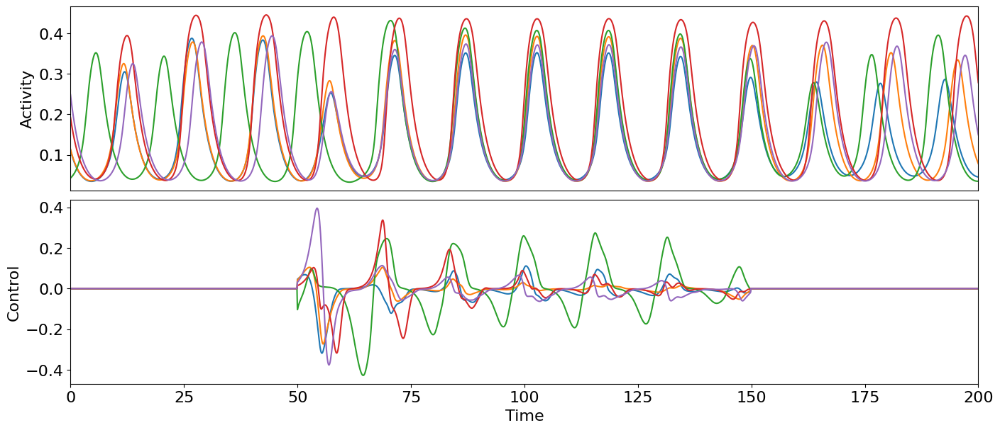

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.019110821175877094
Cost in iteration 10: 0.01911081564409577
Final cost : 0.01911081564409577
Compute control for a deterministic system
Cost in iteration 0: 0.01911081564409577
Converged in iteration 7 with cost 0.019110815644095717
Final cost : 0.019110815644095717


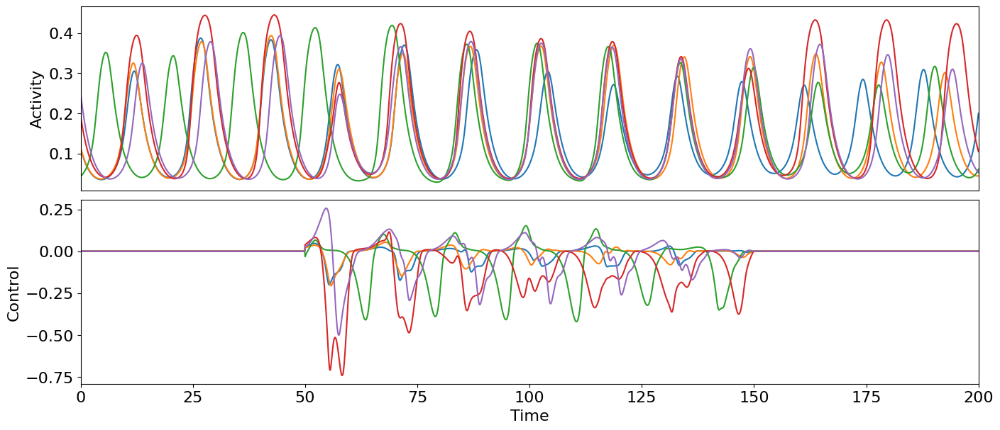

pind =  3
target period =  16.11818181818182
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1.094779550893262
Cost in iteration 10: -1.0947796974642858
Final cost : -1.0947796974642858
Compute control for a deterministic system
Cost in iteration 0: -1.0947796974642858
Cost in iteration 10: -1.0947798244388875
Cost in iteration 20: -1.0947799202127682
Cost in iteration 30: -1.0947800918558435
Cost in iteration 40: -1.0947837123898205
Converged in iteration 45 with cost -1.0947837123949804
Final cost : -1.0947837123949804


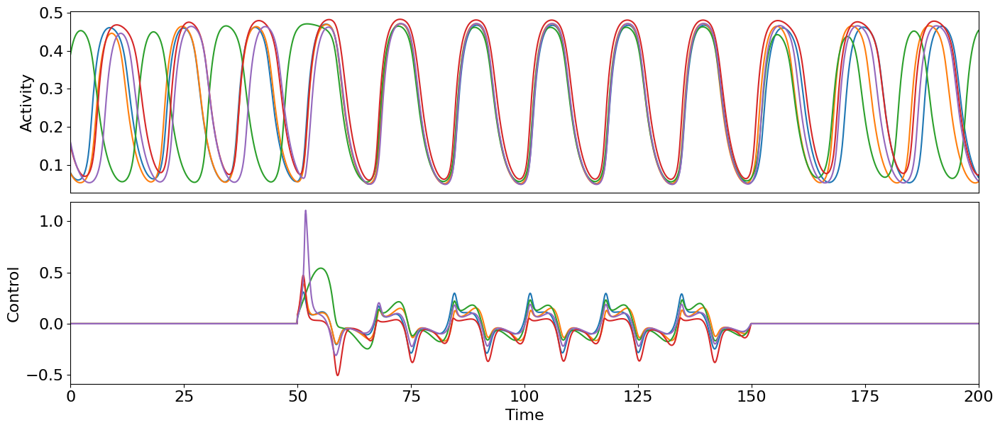

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1.8910198594376024
Converged in iteration 3 with cost -1.891044126185293
Final cost : -1.891044126185293
Compute control for a deterministic system
Cost in iteration 0: -1.891044126185293
Converged in iteration 1 with cost -1.891044126185293
Final cost : -1.891044126185293


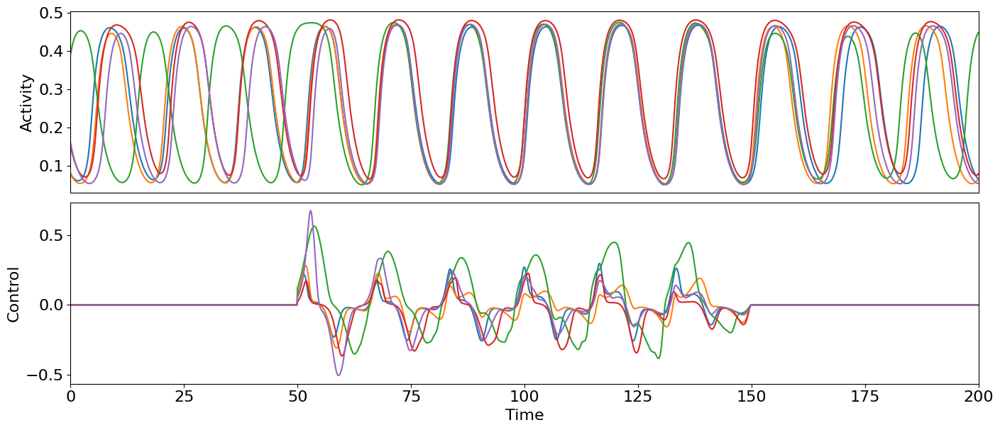

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -2185.23827448691
Cost in iteration 10: -2185.2401580469505
Final cost : -2185.2401580469505
Compute control for a deterministic system
Cost in iteration 0: -2185.2401580469505
Converged in iteration 1 with cost -2185.2401580469505
Final cost : -2185.2401580469505


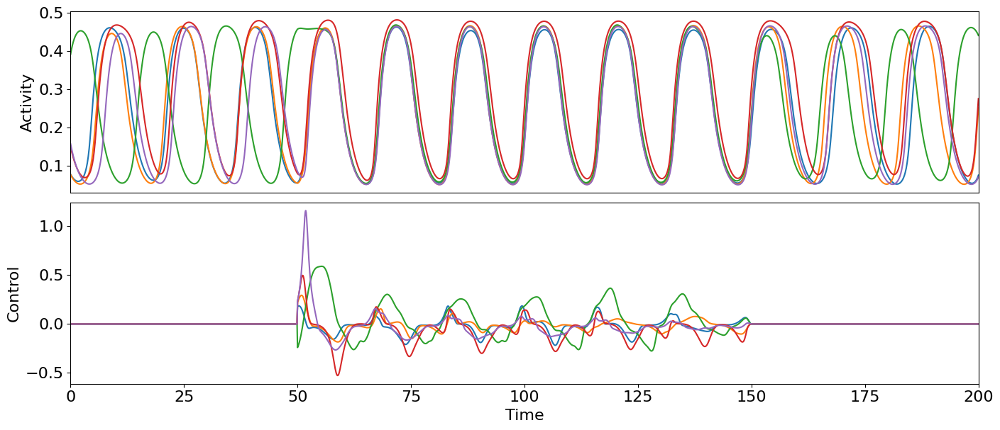

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.06933433605547074
Converged in iteration 1 with cost 0.06933433605547074
Final cost : 0.06933433605547074
Compute control for a deterministic system
Cost in iteration 0: 0.06933433605547074
Converged in iteration 1 with cost 0.06933433605547074
Final cost : 0.06933433605547074


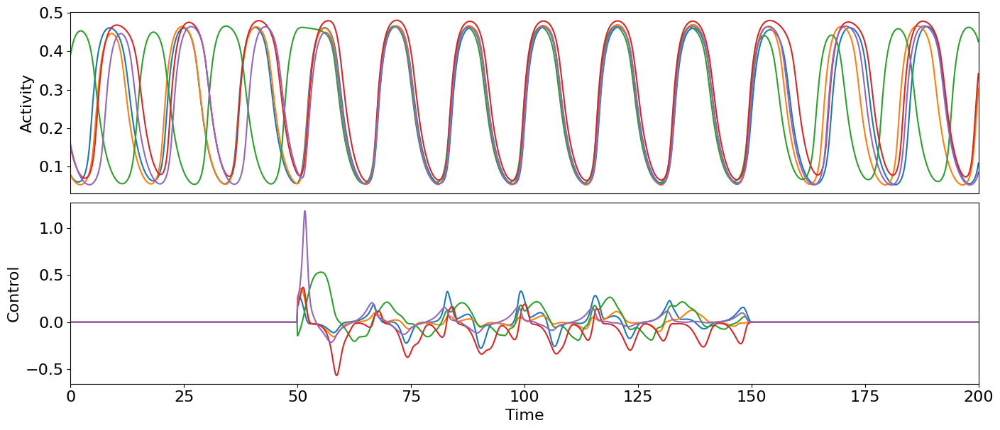

pind =  4
target period =  12.033333333333333
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.653309693995895
Cost in iteration 10: -0.6536969117441511
Final cost : -0.6536969117441511
Compute control for a deterministic system
Cost in iteration 0: -0.6536969117441511
Cost in iteration 10: -0.6541198864856497
Cost in iteration 20: -0.6547900826834916
Cost in iteration 30: -0.6553311429852239
Cost in iteration 40: -0.6556999811123738
Cost in iteration 50: -0.6562292080041673
Cost in iteration 60: -0.6565808710137385
Cost in iteration 70: -0.6568824758578633
Cost in iteration 80: -0.6575077502272133
Cost in iteration 90: -0.6578720110072903
Cost in iteration 100: -0.6582682484486329
Final cost : -0.6615139698260712


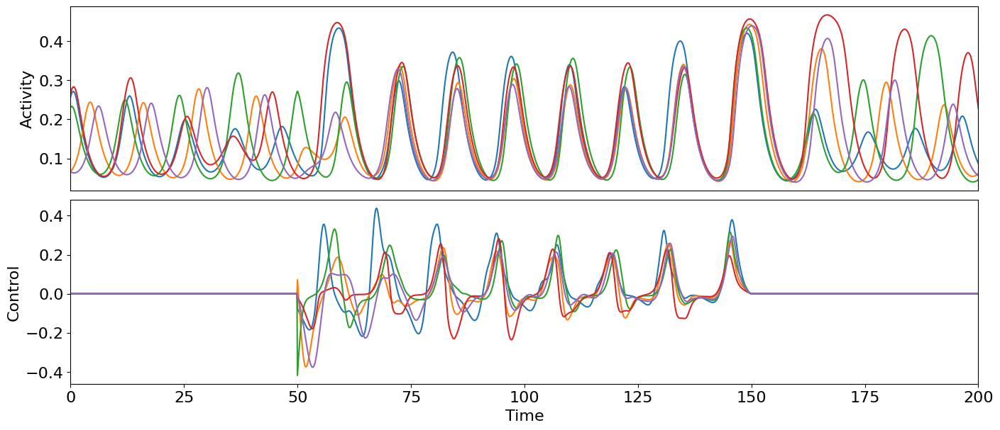

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.9094671934463302
Converged in iteration 1 with cost -0.9094671934463302
Final cost : -0.9094671934463302
Compute control for a deterministic system
Cost in iteration 0: -0.9094671934463302
Converged in iteration 1 with cost -0.9094671934463302
Final cost : -0.9094671934463302


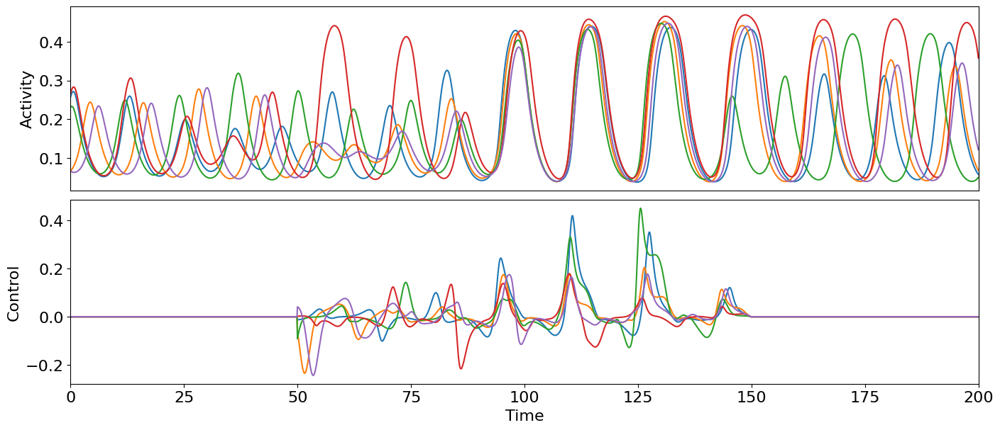

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -2018.356057474658
Cost in iteration 10: -2024.112654424422
Final cost : -2024.112654424422
Compute control for a deterministic system
Cost in iteration 0: -2024.112654424422
Cost in iteration 10: -2025.9781004552083
Cost in iteration 20: -2027.6282603667748
Cost in iteration 30: -2028.93440042933
Cost in iteration 40: -2031.5060610528851
Cost in iteration 50: -2033.3302423408265
Cost in iteration 60: -2034.66445373257
Cost in iteration 70: -2036.0544090890523
Cost in iteration 80: -2037.3642819463455
Cost in iteration 90: -2038.9035336819832
Cost in iteration 100: -2040.3827332628202
Final cost : -2059.670441276359


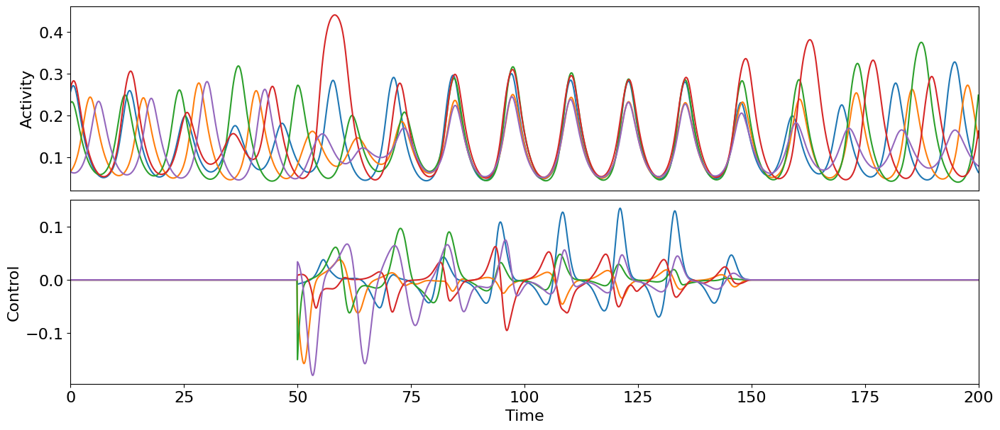

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.04692221647769123
Converged in iteration 1 with cost 0.04692221647769123
Final cost : 0.04692221647769123
Compute control for a deterministic system
Cost in iteration 0: 0.04692221647769123
Converged in iteration 1 with cost 0.04692221647769123
Final cost : 0.04692221647769123


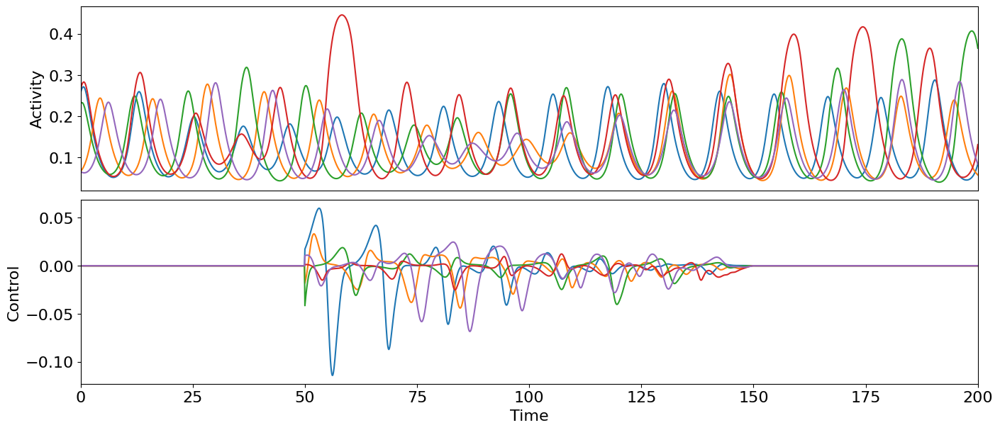

c =  1
pind =  0
target period =  16.461904761904762
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.7238192265769056
Converged in iteration 5 with cost -0.723819226576906
Final cost : -0.723819226576906
Compute control for a deterministic system
Cost in iteration 0: -0.723819226576906
Converged in iteration 1 with cost -0.723819226576906
Final cost : -0.723819226576906


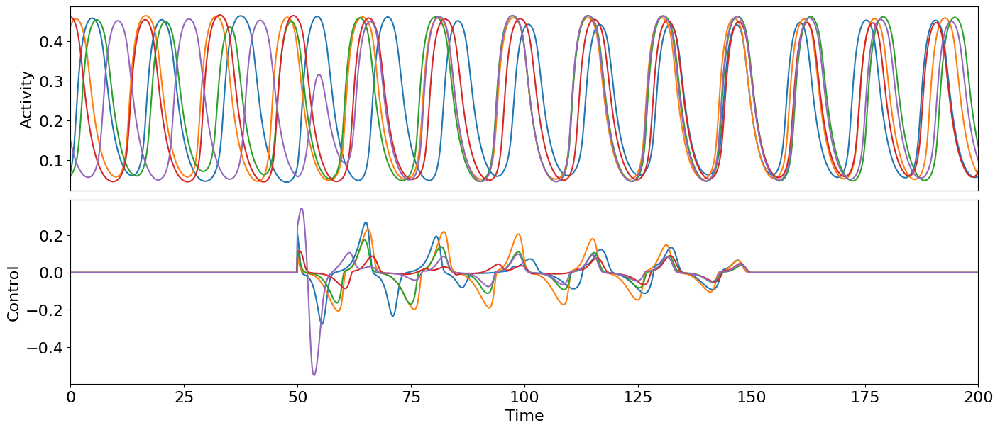

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1.690253826888069
Converged in iteration 2 with cost -1.690253826888069
Final cost : -1.690253826888069
Compute control for a deterministic system
Cost in iteration 0: -1.690253826888069
Converged in iteration 1 with cost -1.690253826888069
Final cost : -1.690253826888069


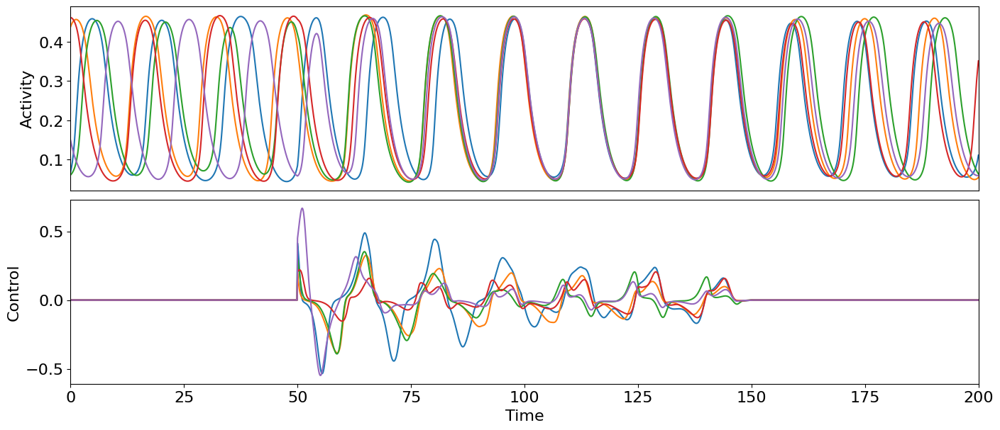

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1528.6680904900968
Converged in iteration 9 with cost -1529.2382405585693
Final cost : -1529.2382405585693
Compute control for a deterministic system
Cost in iteration 0: -1529.2382405585693
Converged in iteration 1 with cost -1529.2382405585693
Final cost : -1529.2382405585693


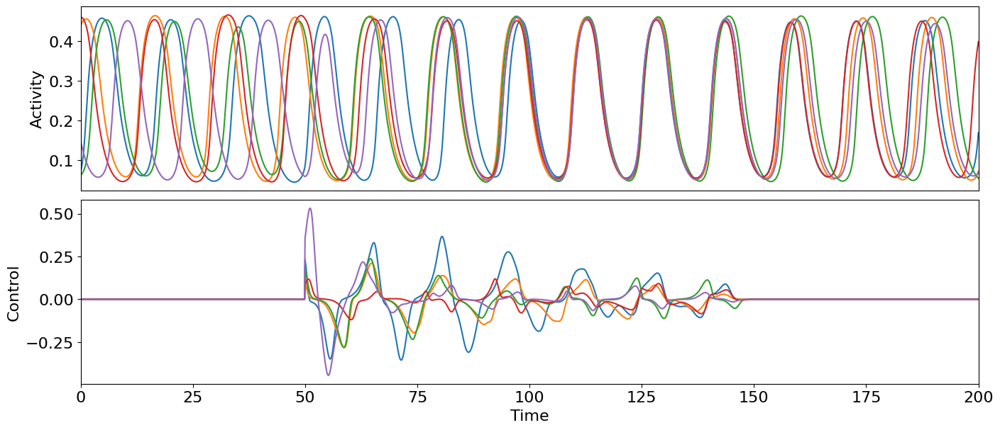

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.20812380671403252
Converged in iteration 1 with cost 0.20812380671403252
Final cost : 0.20812380671403252
Compute control for a deterministic system
Cost in iteration 0: 0.20812380671403252
Converged in iteration 1 with cost 0.20812380671403252
Final cost : 0.20812380671403252


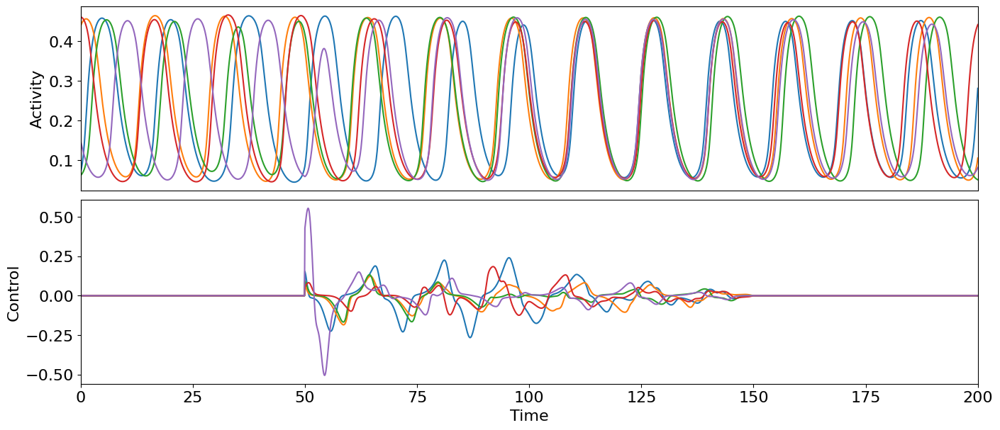

pind =  1
target period =  18.1
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.9542061671097752
Converged in iteration 2 with cost -0.9542061671097752
Final cost : -0.9542061671097752
Compute control for a deterministic system
Cost in iteration 0: -0.9542061671097752
Converged in iteration 1 with cost -0.9542061671097752
Final cost : -0.9542061671097752


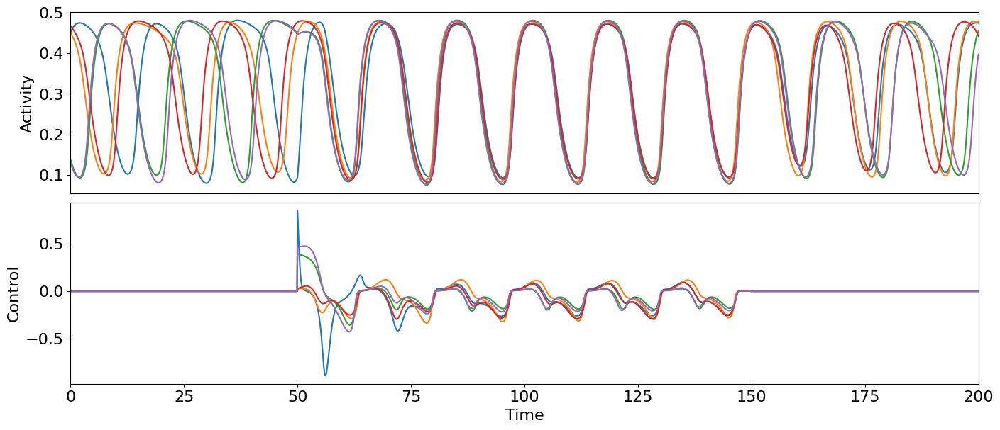

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.47938652102906687
Converged in iteration 10 with cost -0.4793865210290956
Final cost : -0.4793865210290956
Compute control for a deterministic system
Cost in iteration 0: -0.4793865210290956
Converged in iteration 1 with cost -0.4793865210290956
Final cost : -0.4793865210290956


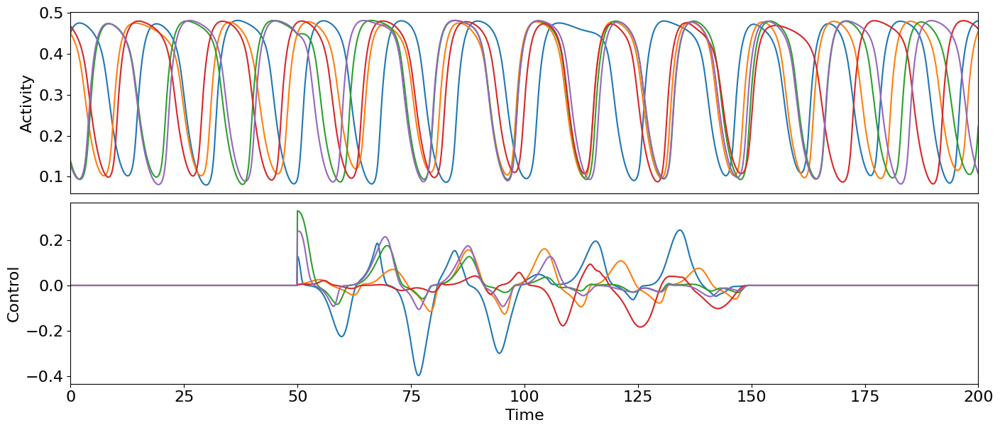

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -717.1052222009366
Converged in iteration 1 with cost -717.1052222009366
Final cost : -717.1052222009366
Compute control for a deterministic system
Cost in iteration 0: -717.1052222009366
Converged in iteration 1 with cost -717.1052222009366
Final cost : -717.1052222009366


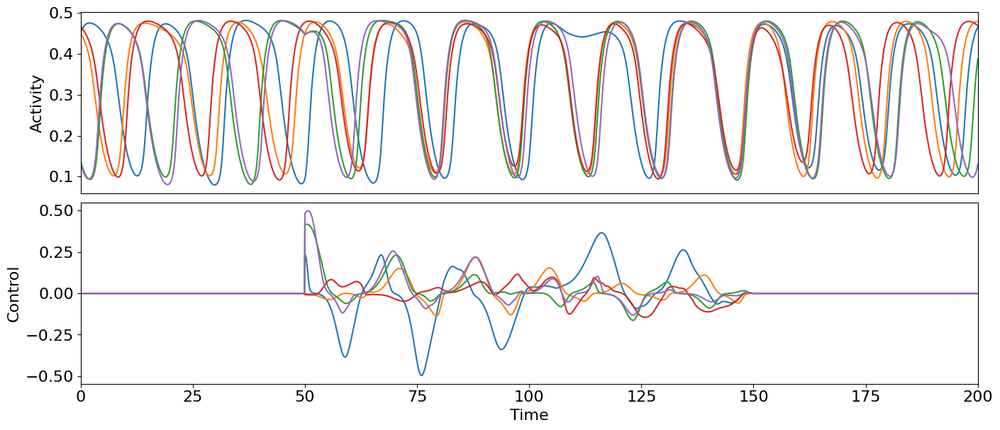

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.0013687026364008436
Cost in iteration 10: 0.00136673672443014
Final cost : 0.00136673672443014
Compute control for a deterministic system
Cost in iteration 0: 0.00136673672443014
Cost in iteration 10: 0.0013649025778193072
Cost in iteration 20: 0.001363140812297082
Cost in iteration 30: 0.0013615152925926246
Cost in iteration 40: 0.0013599370646112828
Cost in iteration 50: 0.001358308031364214
Cost in iteration 60: 0.0013568356676534792
Cost in iteration 70: 0.0013552673745303662
Cost in iteration 80: 0.0013539075498736864
Cost in iteration 90: 0.001351857518254633
Cost in iteration 100: 0.0013504286459190794
Final cost : 0.0013365267493351013


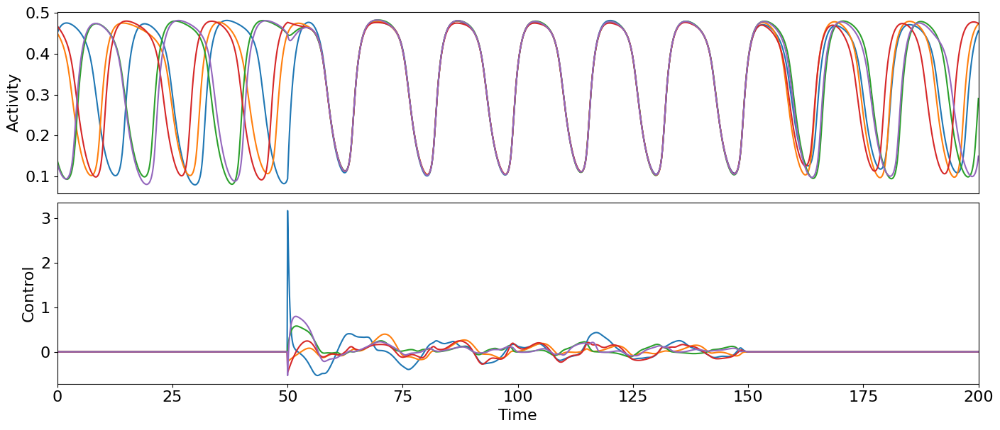

pind =  2
target period =  17.085
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.9193697773117143
Converged in iteration 6 with cost -0.9193697773117145
Final cost : -0.9193697773117145
Compute control for a deterministic system
Cost in iteration 0: -0.9193697773117145
Converged in iteration 1 with cost -0.9193697773117145
Final cost : -0.9193697773117145


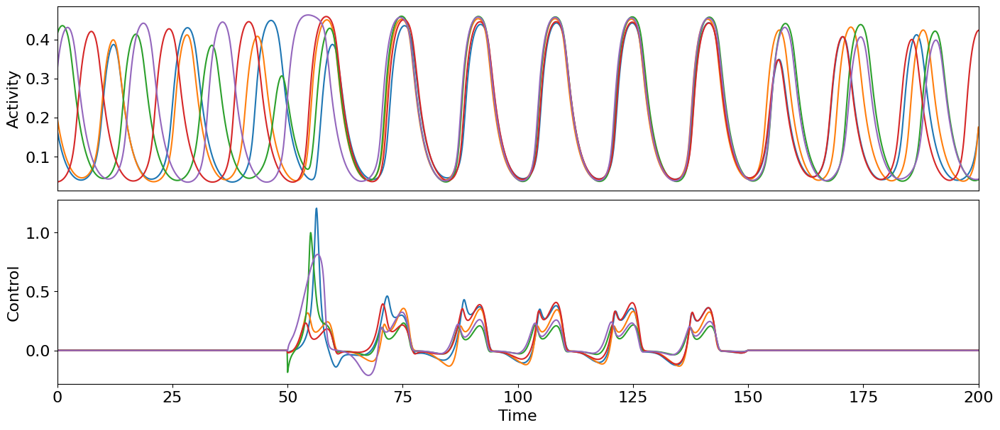

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.9408036087321856
Converged in iteration 2 with cost -0.9408036087321856
Final cost : -0.9408036087321856
Compute control for a deterministic system
Cost in iteration 0: -0.9408036087321856
Converged in iteration 1 with cost -0.9408036087321856
Final cost : -0.9408036087321856


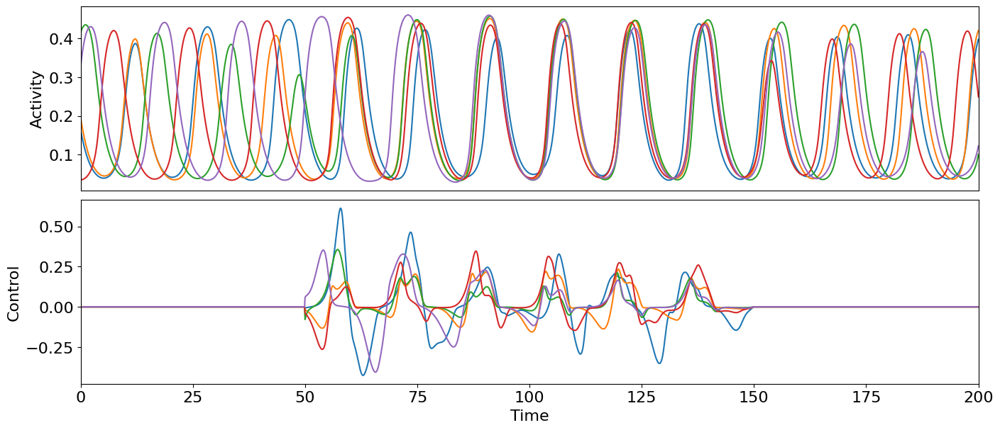

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -549.6308201862552
Cost in iteration 10: -549.6325057736709
Final cost : -549.6325057736709
Compute control for a deterministic system
Cost in iteration 0: -549.6325057736709
Cost in iteration 10: -549.6328795012577
Cost in iteration 20: -549.6328880849252
Cost in iteration 30: -549.6328903063087
Cost in iteration 40: -549.6328903093347
Converged in iteration 49 with cost -549.6328903094675
Final cost : -549.6328903094675


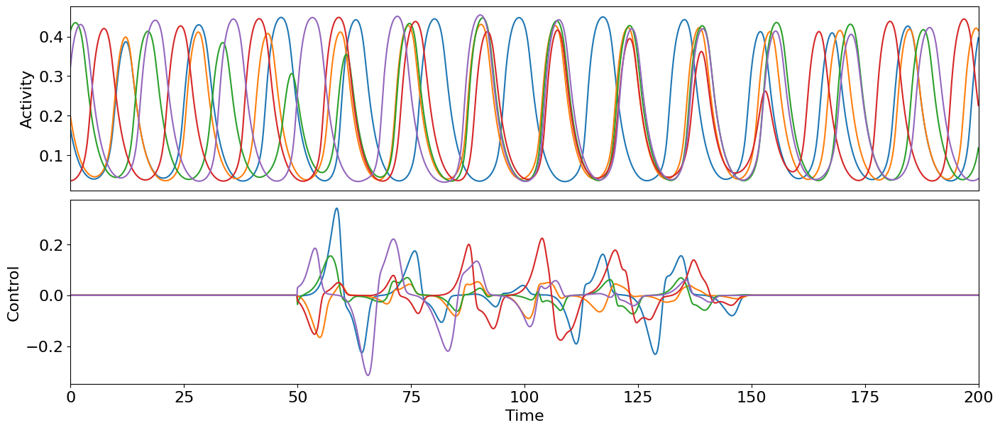

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.09073764970776503
Cost in iteration 10: 0.08835105002212942
Final cost : 0.08835105002212942
control too strong, increase w2 to  0.0002
Compute control for a deterministic system
Cost in iteration 0: 0.5393715862557406
Cost in iteration 10: 0.15133651503991086
Cost in iteration 20: 0.13783599606537125
Final cost : 0.13783599606537125
control too strong, increase w2 to  0.0004
Compute control for a deterministic system
Cost in iteration 0: 0.5393715862557406
Cost in iteration 10: 0.152377176732317
Cost in iteration 20: 0.14022811088261145
Final cost : 0.14022811088261145
control too strong, increase w2 to  0.0008
Compute control for a deterministic system
Cost in iteration 0: 0.5393715862557406
Cost in iteration 10: 0.16093705932253768
Cost in iteration 20: 0.14485810793664666
Final cost : 0.14485810793664666
control too strong, increase w2 to  0.0016
Compute contro

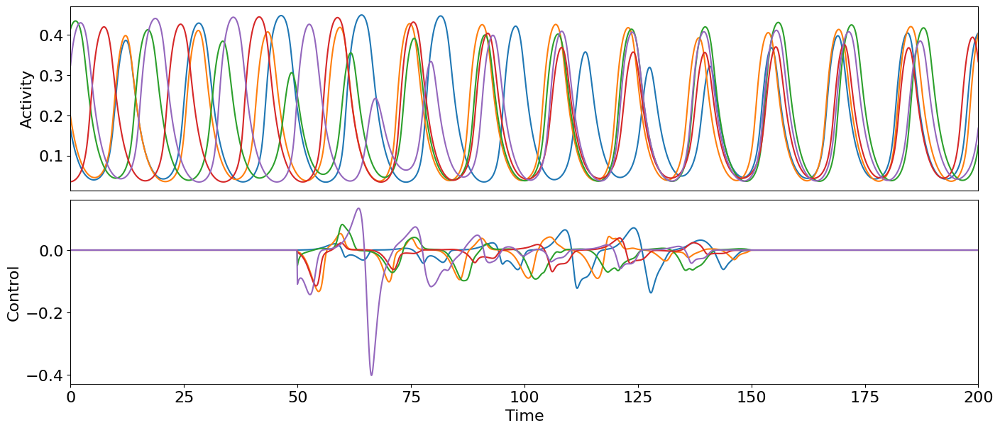

pind =  3
target period =  18.147368421052633
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.7708666693731905
Cost in iteration 10: -0.7708721241291008
Final cost : -0.7708721241291008
Compute control for a deterministic system
Cost in iteration 0: -0.7708721241291008
Cost in iteration 10: -0.7708736380120527
Cost in iteration 20: -0.7708758515554222
Cost in iteration 30: -0.770878850633087
Cost in iteration 40: -0.7708819820705541
Cost in iteration 50: -0.7708840105180755
Cost in iteration 60: -0.7708861495870071
Cost in iteration 70: -0.7708884228228322
Cost in iteration 80: -0.7708899398741595
Cost in iteration 90: -0.770891895235184
Cost in iteration 100: -0.7708937864214918
Final cost : -0.7709345506453966


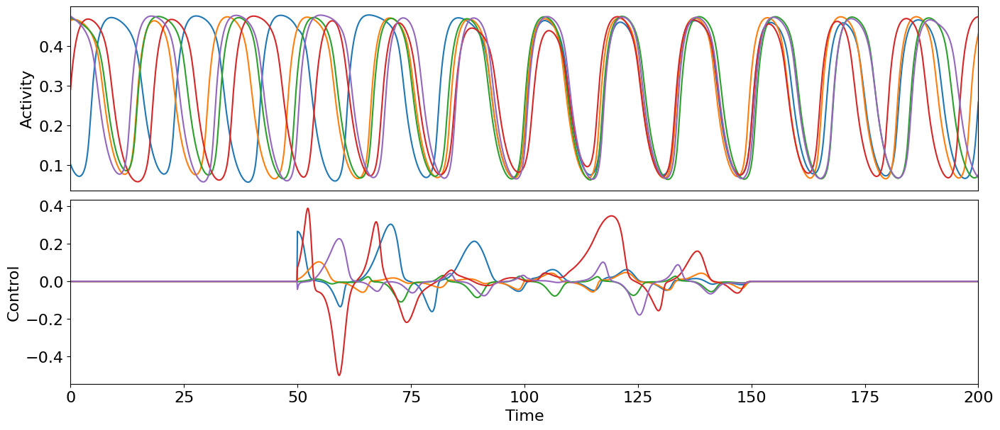

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.43841179888784443
Converged in iteration 2 with cost -0.43841179888784443
Final cost : -0.43841179888784443
Compute control for a deterministic system
Cost in iteration 0: -0.43841179888784443
Converged in iteration 1 with cost -0.43841179888784443
Final cost : -0.43841179888784443


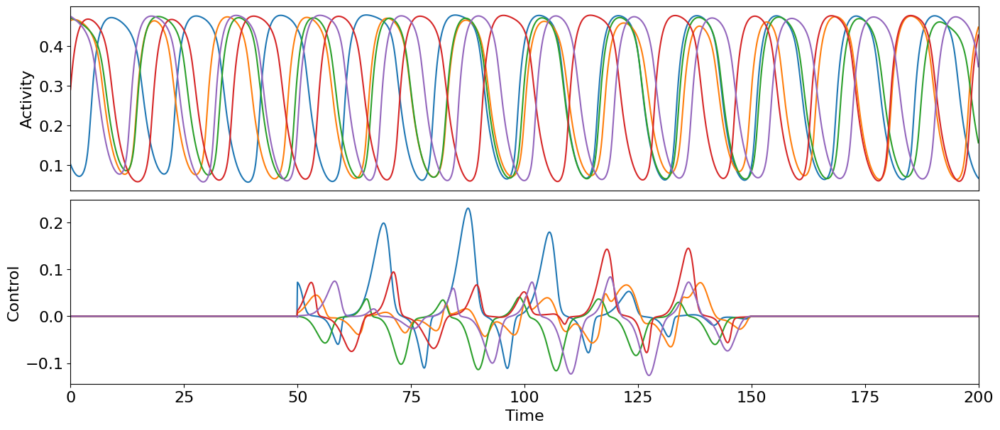

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -2043.4421946683833
Converged in iteration 5 with cost -2045.127036848414
Final cost : -2045.127036848414
Compute control for a deterministic system
Cost in iteration 0: -2045.127036848414
Converged in iteration 1 with cost -2045.127036848414
Final cost : -2045.127036848414


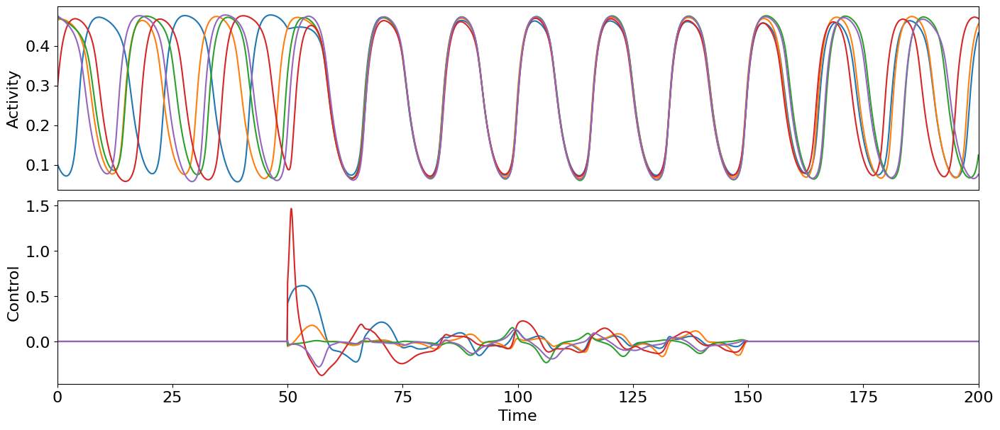

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.39647194231352795
Converged in iteration 1 with cost 0.39647194231352795
Final cost : 0.39647194231352795
Compute control for a deterministic system
Cost in iteration 0: 0.39647194231352795
Converged in iteration 1 with cost 0.39647194231352795
Final cost : 0.39647194231352795


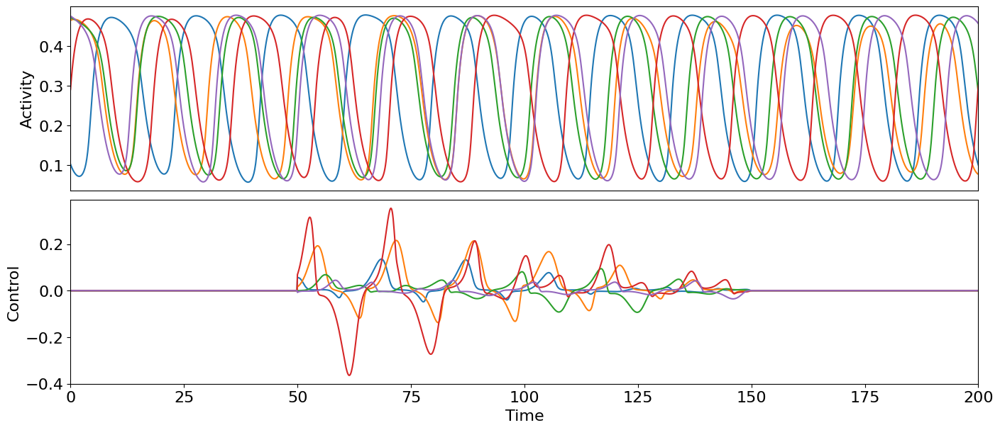

pind =  4
target period =  18.573684210526316
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.6377133505740507
Cost in iteration 10: -0.6398288964232658
Final cost : -0.6398288964232658
Compute control for a deterministic system
Cost in iteration 0: -0.6398288964232658
Cost in iteration 10: -0.6408086850078742
Cost in iteration 20: -0.6422010322543543
Cost in iteration 30: -0.6440001929415196
Cost in iteration 40: -0.6450377985846979
Cost in iteration 50: -0.6465809056709256
Cost in iteration 60: -0.648003612820029
Cost in iteration 70: -0.6486057896209305
Cost in iteration 80: -0.6512964134464688
Cost in iteration 90: -0.6535481709932246
Cost in iteration 100: -0.6547687048799048
Final cost : -0.6762548630750682


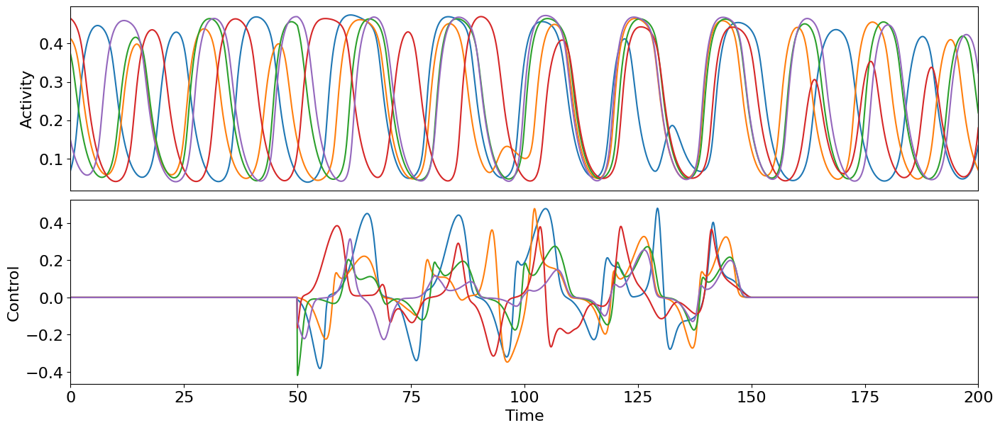

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.42683822814664907
Cost in iteration 10: -0.426863844286086
Final cost : -0.426863844286086
Compute control for a deterministic system
Cost in iteration 0: -0.426863844286086
Converged in iteration 5 with cost -0.4268638442860866
Final cost : -0.4268638442860866


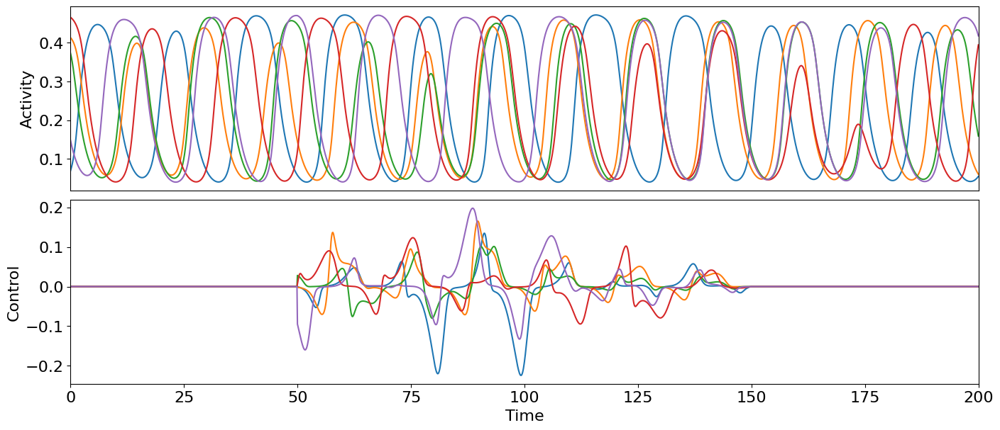

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -869.7692500024618
Cost in iteration 10: -869.7692500115282
Final cost : -869.7692500115282
Compute control for a deterministic system
Cost in iteration 0: -869.7692500115282
Cost in iteration 10: -869.7692500128024
Converged in iteration 20 with cost -869.7692500129168
Final cost : -869.7692500129168


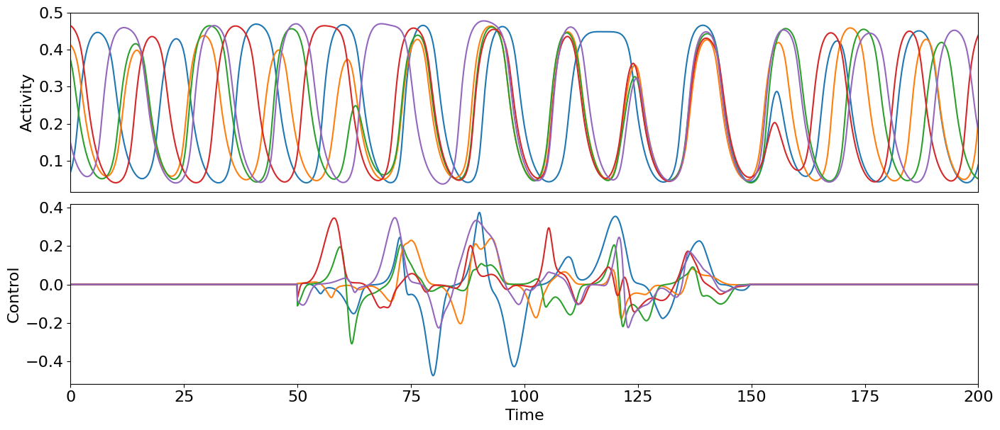

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.2759114700007296
Converged in iteration 1 with cost 0.2759114700007296
Final cost : 0.2759114700007296
Compute control for a deterministic system
Cost in iteration 0: 0.2759114700007296
Converged in iteration 1 with cost 0.2759114700007296
Final cost : 0.2759114700007296


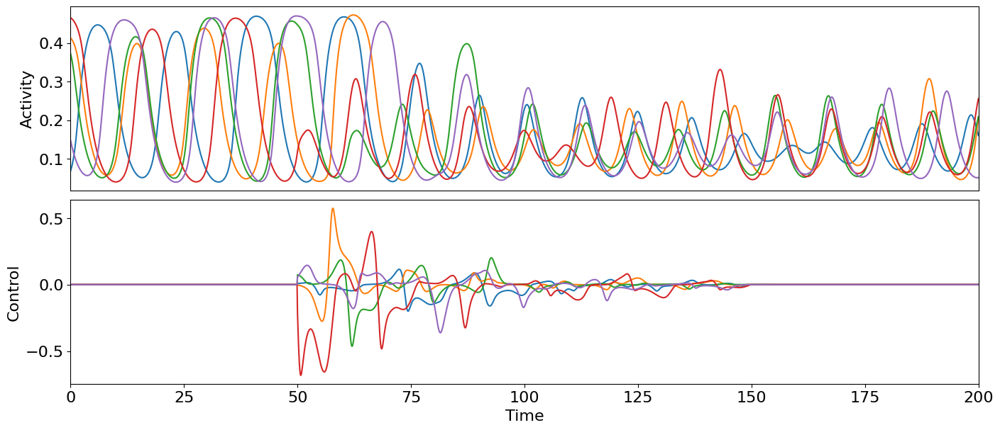

c =  2
pind =  0
target period =  16.45714285714286
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.6689771887350592
Cost in iteration 10: -0.6701326851327696
Final cost : -0.6701326851327696
control too strong, increase w2 to  0.0512
Compute control for a deterministic system
Cost in iteration 0: -0.4758545786178053
Cost in iteration 10: -0.5777459515205017
Cost in iteration 20: -0.5825060286823912
Final cost : -0.5825060286823912
Compute control for a deterministic system
Cost in iteration 0: -0.5825060286823912
Cost in iteration 10: -0.582696868926605
Cost in iteration 20: -0.5827020081735308
Cost in iteration 30: -0.5827049669666324
Cost in iteration 40: -0.5827066930124113
Cost in iteration 50: -0.5827080856286392
Cost in iteration 60: -0.5827084444607659
Cost in iteration 70: -0.5827088064215201
Cost in iteration 80: -0.5827089989733284
Cost in iteration 90: -0.5827091430531302
Cost in iteration 100: -0.5

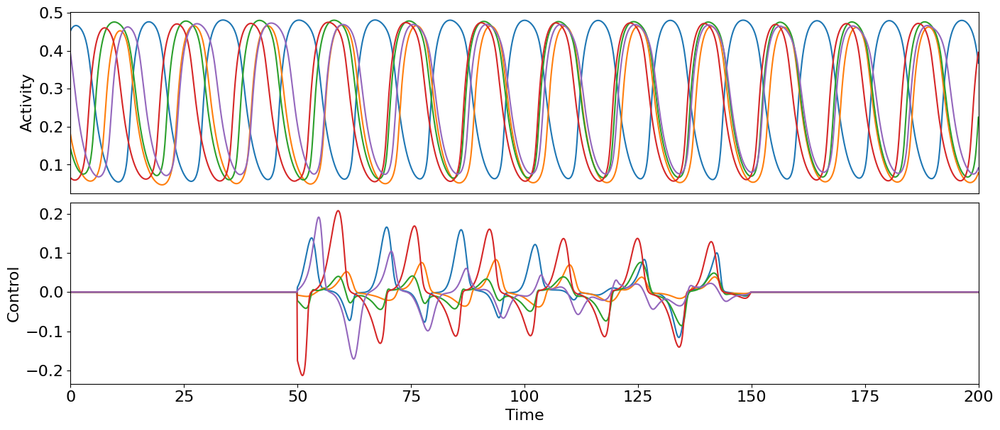

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.6993643637030158
Converged in iteration 1 with cost -0.6993643637030158
Final cost : -0.6993643637030158
Compute control for a deterministic system
Cost in iteration 0: -0.6993643637030158
Converged in iteration 1 with cost -0.6993643637030158
Final cost : -0.6993643637030158


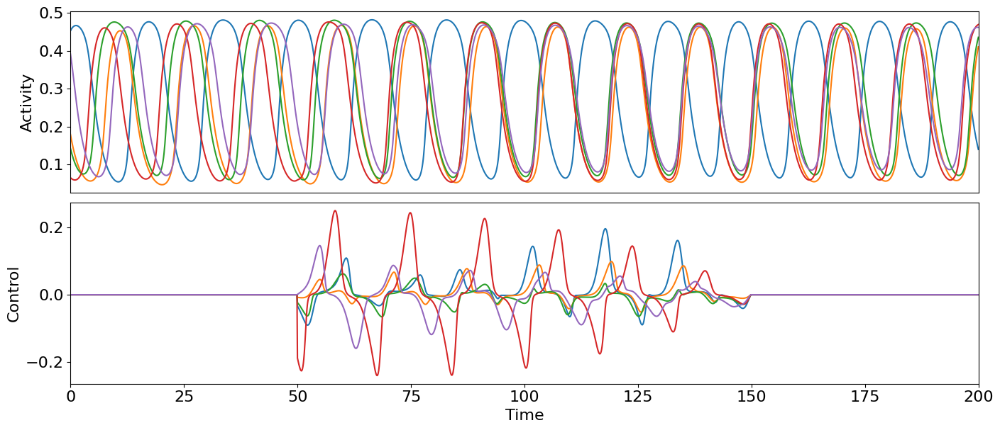

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1086.8143007503788
Converged in iteration 1 with cost -1086.8143007503788
Final cost : -1086.8143007503788
Compute control for a deterministic system
Cost in iteration 0: -1086.8143007503788
Converged in iteration 1 with cost -1086.8143007503788
Final cost : -1086.8143007503788


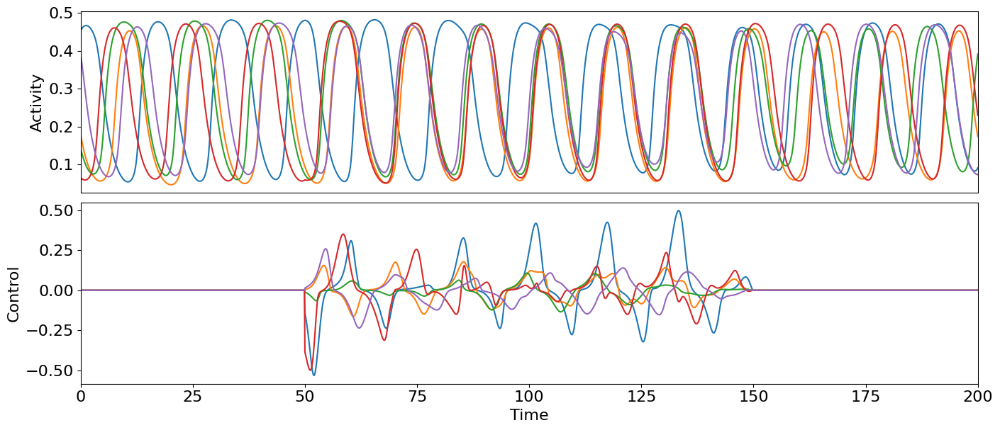

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.10779834697717405
Converged in iteration 1 with cost 0.10779834697717405
Final cost : 0.10779834697717405
Compute control for a deterministic system
Cost in iteration 0: 0.10779834697717405
Converged in iteration 1 with cost 0.10779834697717405
Final cost : 0.10779834697717405


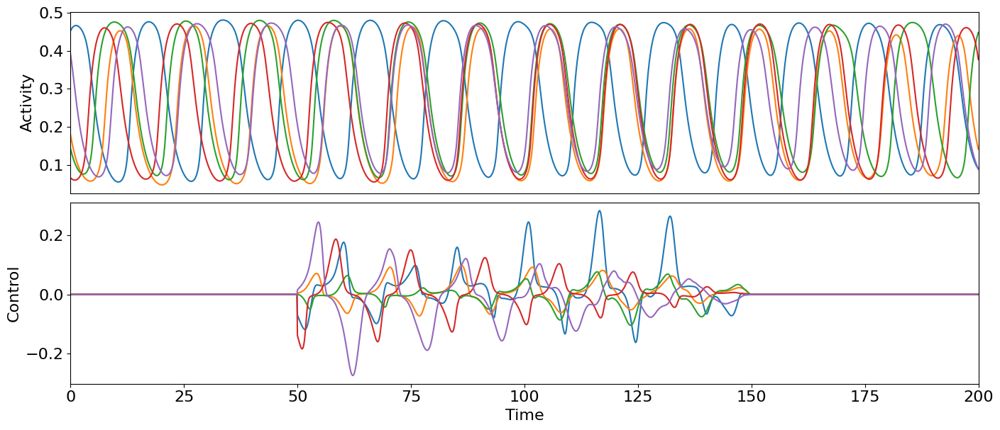

pind =  1
pind =  2
target period =  16.77
imet =  0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.6072993788705054
Converged in iteration 1 with cost -0.6072993788705054
Final cost : -0.6072993788705054
Compute control for a deterministic system
Cost in iteration 0: -0.6072993788705054
Converged in iteration 1 with cost -0.6072993788705054
Final cost : -0.6072993788705054


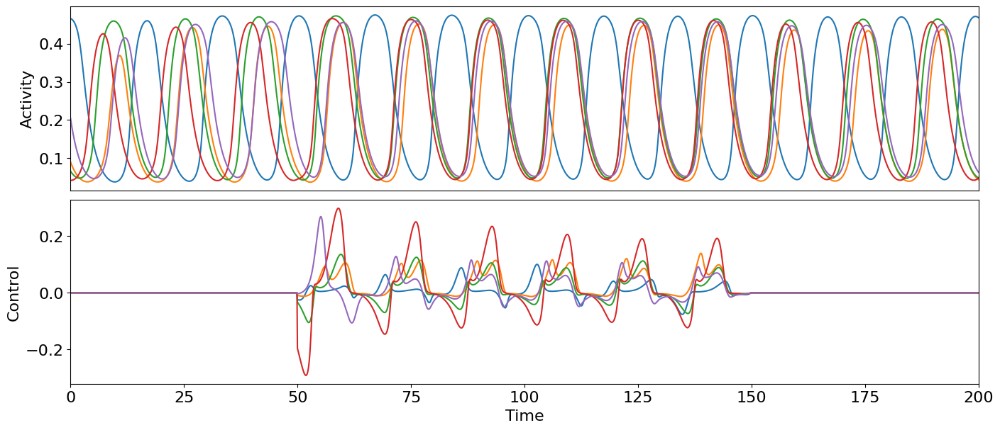

imet =  1
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.8581837360925119
Cost in iteration 10: -0.8582490380713118
Final cost : -0.8582490380713118
control too strong, increase w2 to  0.2048
Compute control for a deterministic system
Cost in iteration 0: -0.46009430588778477
Cost in iteration 10: -0.6862468151021484
Converged in iteration 17 with cost -0.6865416415105301
Final cost : -0.6865416415105301
Compute control for a deterministic system
Cost in iteration 0: -0.6865416415105301
Converged in iteration 1 with cost -0.6865416415105301
Final cost : -0.6865416415105301


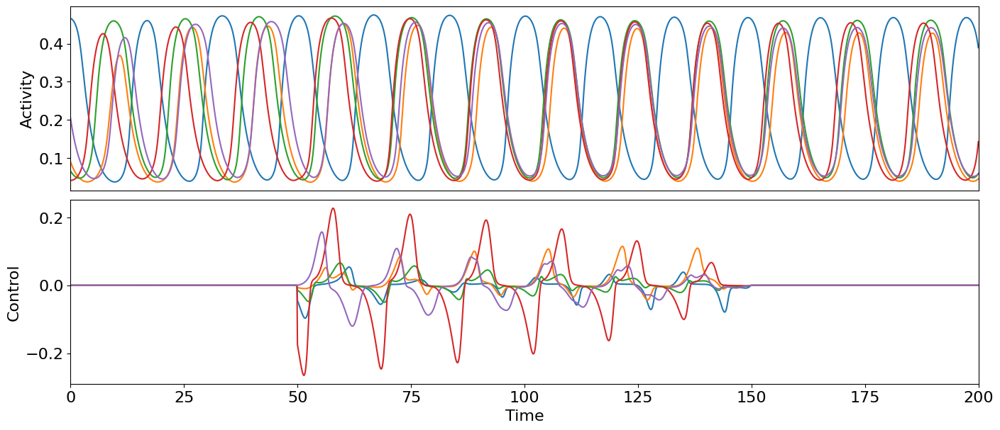

imet =  2
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -1679.1485168751608
Cost in iteration 10: -1682.303591457876
Final cost : -1682.303591457876
Compute control for a deterministic system
Cost in iteration 0: -1682.303591457876
Cost in iteration 10: -1685.6996243206195
Cost in iteration 20: -1696.8602099589386
Cost in iteration 30: -1699.7989836430709
Cost in iteration 40: -1702.5902979310433
Cost in iteration 50: -1705.9765676340062
Cost in iteration 60: -1708.1321525043752
Cost in iteration 70: -1709.7133379529314
Cost in iteration 80: -1712.2060600498637
Cost in iteration 90: -1713.709344875433
Cost in iteration 100: -1724.7624834091034
Final cost : -1759.1073398845958


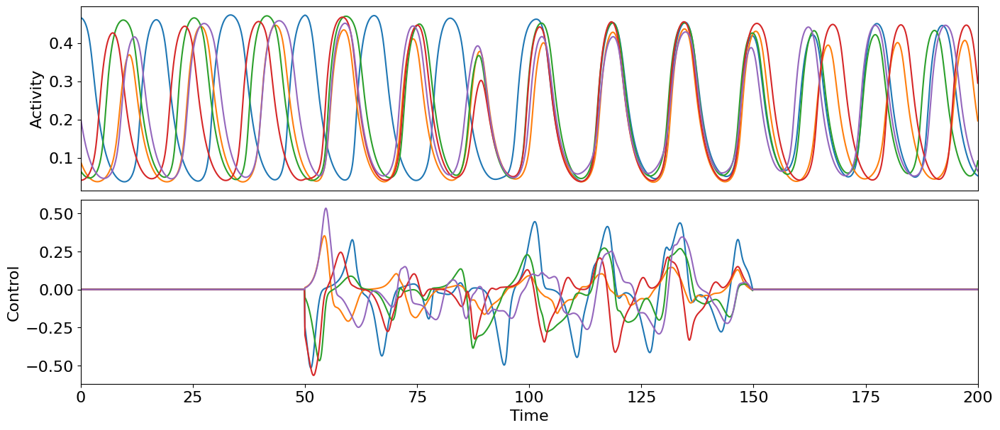

imet =  3
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: 0.12038627408317497
Converged in iteration 3 with cost 0.12038619887676084
Final cost : 0.12038619887676084
Compute control for a deterministic system
Cost in iteration 0: 0.12038619887676084
Converged in iteration 1 with cost 0.12038619887676084
Final cost : 0.12038619887676084


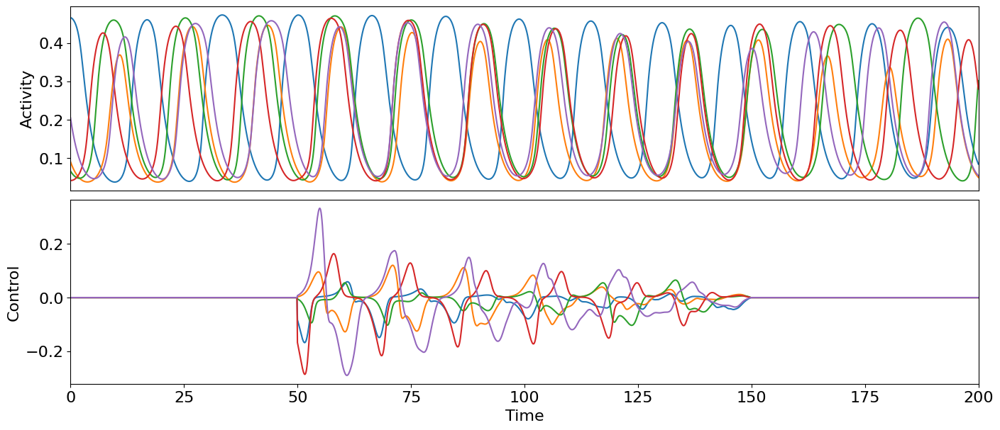

pind =  3
pind =  4


In [252]:
it = 200
pr = np.arange(0,101,10)
maxstr = 10.
init_control = zero_control.copy()
LIMC = 0.5

for c in range(len(cmats)):
    print("c = ", c)

    model = WCModel(Cmat=cmats[c], Dmat=dmats[c])

    dt = model.params['dt']
    model.params.signalV = 1.

    nmaxdel = model.getMaxDelay()

    for pind in range(len(points)):

        print("pind = ", pind)

        if [c, pind] in skip_array:
            continue

        p = points[pind]
        
        testd = 1000.
        model.params.duration = testd
        test_input = ZeroInput().generate_input(duration=testd+dt, dt=dt)
        test_input[0,:500] = -5.
        model.params["exc_ext"] = test_input + p[0]
        model.params["inh_ext"] = test_input + p[1]

        einit = np.zeros((N, nmaxdel+1))
        iinit = np.zeros((N, nmaxdel+1))

        model.params["exc_init"] = einit
        model.params["inh_init"] = iinit
        model.run()

        for n in range(N):
            einit[n,:] = model.exc[n,-1]
            iinit[n,:] = model.inh[n,-1]

        model.params.duration = duration

        model.params["exc_ext"] = zero_control[:,0,:] + p[0]
        model.params["inh_ext"] = zero_control[:,0,:] + p[1]

        model.params["exc_init"] = einit
        model.params["inh_init"] = iinit

        model.run()
            
        int0 = 500
        int1 = 1500

        print("target period = ", periods_array[c, pind])

        for imet in range(4):
            
            print("imet = ", imet)

            w2 = results["w2"][c, pind, imet]
                
            if w2 == 0:
                w2 = 1e-4

            model_controlled = oc_wc.OcWc(model, periods_array[c, pind], print_array=pr, cost_interval=(int0,int1), control_interval=(int0,int1), cost_matrix=costmat, control_matrix = controlmat)
            model_controlled.maximum_control_strength = maxstr
            model_controlled.channelwise_optimization = True
            model_controlled.step = 1e-1
            model_controlled.weights["w_p"] = 0.
            model_controlled.weights["w_2"] = w2

            if imet == 0:
                model_controlled.weights["w_f_sync"] = 1.
            elif imet == 1:
                model_controlled.weights["w_cc"] = 1.
            elif imet == 2:
                model_controlled.weights["w_cc1"] = 1.
            elif imet == 3:
                model_controlled.weights["w_var"] = 1.

            if type(results["controls"][c][pind][imet]) != type(None):
                model_controlled.control = results["controls"][c][pind][imet].copy()
                model_controlled.update_input()

            model_controlled.optimize(10)

            while np.amax(np.abs(model_controlled.control[:,:,int0+100:])) > LIMC:
                w2 *= 2
                model_controlled.weights["w_2"] = w2
                print("control too strong, increase w2 to ", w2)
                
                model_controlled.control = zero_control
                model_controlled.update_input()
                model_controlled.step = 1e0
                model_controlled.zero_step_encountered = False
                model_controlled.optimize(20)

            model_controlled.optimize(it)

            results["controls"][c][pind][imet] = model_controlled.control.copy()
            results["states"][c][pind][imet] = model_controlled.get_xs()

            timings, periods = getperiods(model_controlled.get_xs(), dt, N, interval=(int0, int1))
            results["timings"][c][pind][imet] = timings
            results["periods"][c][pind][imet] = periods
            results["nat_periods"][c, pind, imet] = periods_array[c, pind]
            results["w2"][c, pind, imet] = w2

            fname = str(c) + "_" + str(pind) + "_" + str(imet) + ".png"
            plot_oc_nw(N, duration, dt, model_controlled.get_xs(), 200, model_controlled.control, filename= os.path.join(dir, fname))

        # save after each cmat point
        with open('snyc_5n.pickle', 'wb') as f:
            pickle.dump(results, f)

In [250]:
with open('snyc_5n.pickle', 'wb') as f:
    pickle.dump(results, f)

In [7]:
with open('snyc_5n.pickle', 'rb') as f:
    res_read = pickle.load(f)
    print(res_read.keys() )

results = res_read.copy()

dict_keys(['controls', 'periods', 'timings'])


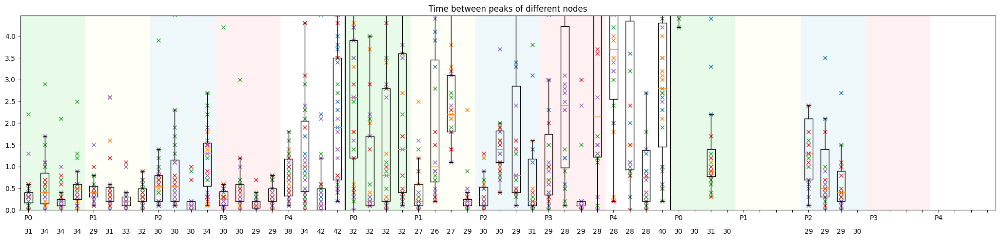

In [251]:
xl = [ "P0", "P1", "P2", "P3", "P4"]

ydata = []
xlabels = []
fig = plt.figure(figsize =(20, 4))
ax = fig.add_axes([0, 0, 1, 1])

xpos = 0

for c in range(len(cmats)):
    for pind in range(len(points)):
        for imet in range(4):

            if imet == 0:
                xlabels.append(xl[pind])
            else:
                xlabels.append(" ")

            data = results["timings"][c][pind][imet]
            ydata_ = []

            if [c, pind] in skip_array:
                ydata.append(ydata_)
                xpos += 1
                continue

            if data is None:
                ydata.append(ydata_)
                xpos += 1
                continue

            n_maxpeaks = 0

            for n in range(1, N):
                if len(data[n]) > len(data[n_maxpeaks]):
                    n_maxpeaks = n

            n_datapoints = 0

            for n in range(N):
                n_datapoints += len(data[n])
                if n == n_maxpeaks:
                    continue
                for p in data[n]:
                    dpoint = np.amin(np.abs(p - data[n_maxpeaks])) * dt
                    ydata_.append( dpoint )
                    ax.plot(xpos+1, dpoint, marker="x", color=colors[n])
            ax.text(xpos+1, -0.5, str(n_datapoints), horizontalalignment='center', verticalalignment='center')

            ydata.append(ydata_)

            xpos += 1


ax.boxplot(ydata, showfliers=False)
ax.set_xticklabels(xlabels)
y0, y1 = 0., 0.2 * np.amax(periods_array)
ax.set_ylim(y0, y1)
ax.set_xlim(0.5, len(xlabels)+0.5)
for i in range(4):
    ax.axvspan(0.5 + i*20, 4.5 + i*20, facecolor='lightgreen', alpha=0.2)
    ax.axvspan(4.5 + i*20, 8.5 + i*20, facecolor='lightyellow', alpha=0.2)
    ax.axvspan(8.5 + i*20, 12.5 + i*20, facecolor='lightblue', alpha=0.2)
    ax.axvspan(12.5 + i*20, 16.5 + i*20, facecolor='lightpink', alpha=0.2)
ax.vlines([20.5, 40.5], y0, y1, colors=["k", "k"])
ax.set_title(r"Time between peaks of different nodes")
plt.show()
fig.savefig(os.path.join(dir, "timings.png"), bbox_inches='tight')